# Import Files

In [290]:
# Import Packages

%load_ext autoreload
%autoreload 2

import os
import warnings 
warnings.filterwarnings('ignore')
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import anndata as ad
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from anndata import AnnData
from natsort import natsorted
from tqdm.notebook import tqdm

# Customized packages
import starmap.sc_util as su
# test()

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [291]:
# confirm your installation by importing the libraries
import os
import numpy as np
import pandas as pd
import scanpy as sc
import anndata as ad
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from anndata import AnnData
from tqdm.notebook import tqdm
import scanpy.external as sce
# import starmap.sc_util as su
import harmonypy

import sys
import numpy as np
import pandas as pd
import seaborn as sns
# from starmap.sequencing import *
from natsort import natsorted
from scipy.io import loadmat, savemat
from skimage.filters import threshold_otsu

In [3]:
##Set path
base_path = ''

input_path = os.path.join(base_path, 'input')

out_path = os.path.join(base_path, 'output')
if not os.path.exists(out_path):
    os.mkdir(out_path)
    
fig_path = os.path.join(base_path, 'figures')
if not os.path.exists(fig_path):
    os.mkdir(fig_path)

sc.settings.figdir = fig_path

In [319]:
# load adata for combined STARmap and RIBOmap samples
adata = sc.read_h5ad(os.path.join(out_path, '2023-11-30-Nectow-Lab-combined-HARMONY.h5ad'))
adata

AnnData object with n_obs × n_vars = 85072 × 256
    obs: 'sample', 'area', 'protocol', 'x', 'y', 'seg_label', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_5_genes', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'n_genes', 'n_counts', 'protocol-sample'
    var: 'max_counts_sample1_STARmap', 'max_counts_sample2_STARmap', 'max_counts_sample3_STARmap', 'max_counts_sample4_STARmap', 'max_counts_sample5_RIBOmap', 'max_counts_sample6_RIBOmap', 'max_counts_sample7_RIBOmap', 'max_counts_sample8_RIBOmap', 'detected', 'highly_variable', 'mean', 'std'
    uns: 'log1p', 'neighbors', 'pca', 'protocol-sample_colors', 'protocol_colors', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'combat', 'corrected', 'raw', 'scaled'
    obsp: 'connectivities', 'distances'

In [123]:
# load adata for Sabatini eLife dataset
adata_sc = sc.read_h5ad(os.path.join(out_path, 'Sabatini_sc_combined.h5ad'))
adata_sc

AnnData object with n_obs × n_vars = 39411 × 17138
    obs: 'nGene', 'nUMI', 'Reads', 'UMIFM', 'BatchID', 'Condition', 'orig.ident', 'Sex', 'percent.mito', 'var.ratio.pca', 'res.3', 'ClusterNumbers_cca.aligned_1.35_res_3', 'res.2', 'ClusterNumbers_cca.aligned_1.35_res_2', 'tree.ident', 'ClusterTreeNumbers_filtered', 'CellClassNames_filtered', 'Curated_subtypeLabels', 'Curated_cellTypeLabels', 'Curated_cellTypeLabels_ordered', 'batch'

In [6]:
# Get gene lists for adata_sc and adata
genes_sc = adata_sc.var_names
print(genes_sc.shape)
genes_starribo = adata.var_names
print(genes_starribo.shape)

(17138,)
(256,)


In [7]:
# Find the overlapping genes between the two datasets
overlapping_genes = np.intersect1d(genes_sc, genes_starribo)
print(overlapping_genes.shape)

adata_sc_subset = adata_sc[:, overlapping_genes]
adata_subset = adata[:, overlapping_genes]

(227,)


In [10]:
# Normalization scaling sc
sc.pp.normalize_total(adata_sc_subset)
sc.pp.log1p(adata_sc_subset)


# Calculate QC metrics - sc
sc.pp.calculate_qc_metrics(adata_sc_subset, percent_top=None, inplace=True)


# Scale data to unit variance and zero mean - sc
sc.pp.regress_out(adata_sc_subset, ['total_counts'])
sc.pp.scale(adata_sc_subset)

In [14]:
##Generating the combined dataset

combine_adata=adata_subset.concatenate(adata_sc_subset,batch_key='dataset', join = 'outer', batch_categories=['STAR-RIBOmap','scrna-Sabatini'])

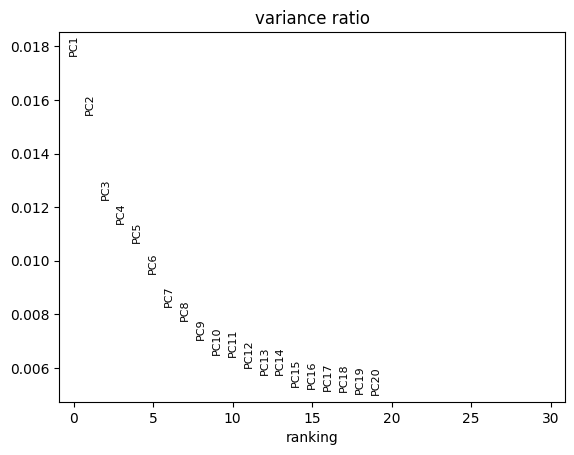

In [16]:
##PCA

sc.tl.pca(combine_adata,n_comps=20)
sc.pl.pca_variance_ratio(combine_adata)

In [17]:
#Single cell integration

import scanpy.external as sce
sce.pp.harmony_integrate(combine_adata, 'dataset')

2024-01-25 18:37:35,547 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-01-25 18:37:54,036 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-01-25 18:37:54,862 - harmonypy - INFO - Iteration 1 of 10
2024-01-25 18:38:45,299 - harmonypy - INFO - Iteration 2 of 10
2024-01-25 18:39:36,247 - harmonypy - INFO - Iteration 3 of 10
2024-01-25 18:40:26,834 - harmonypy - INFO - Iteration 4 of 10
2024-01-25 18:41:14,166 - harmonypy - INFO - Iteration 5 of 10
2024-01-25 18:42:02,386 - harmonypy - INFO - Iteration 6 of 10
2024-01-25 18:42:22,791 - harmonypy - INFO - Converged after 6 iterations


In [18]:

sc.pp.neighbors(combine_adata,n_neighbors=70,use_rep='X_pca_harmony')

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


In [19]:
sc.tl.umap(combine_adata)

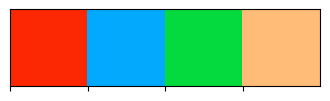

In [20]:
##Generating a color map

cluster_pl = sns.color_palette("tab20",4)
cluster_pl[0]=np.array([252,40,3])/255
cluster_pl[1]=np.array([3, 169, 252])/255
cluster_pl[2]=np.array([4,217,61])/255
# cluster_pl=list(np.random.rand(4,3))
sns.palplot(cluster_pl)

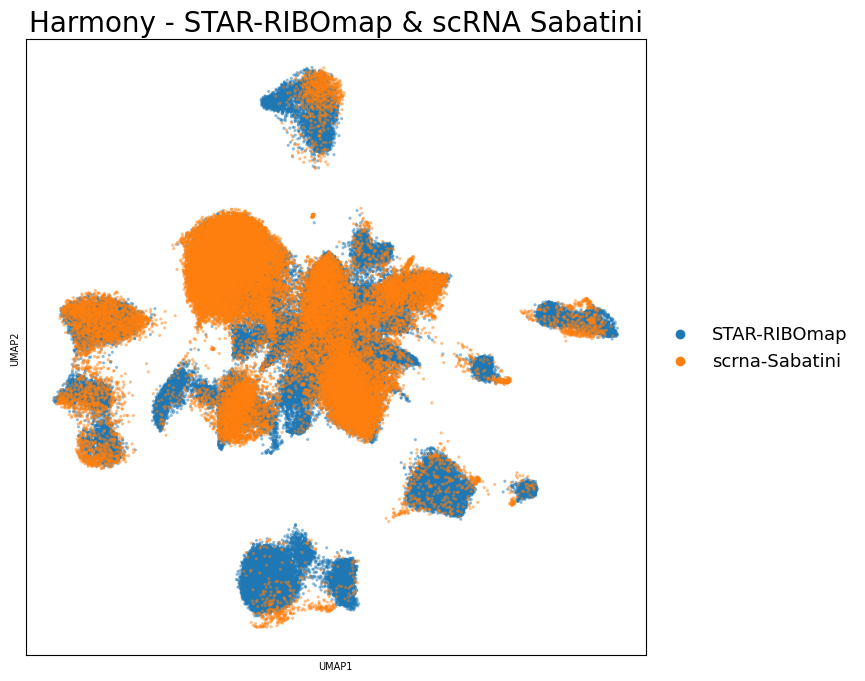

In [21]:
import matplotlib.pyplot as plt
fig,ax = plt.subplots(figsize=(8,8))
for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] +
             ax.get_xticklabels() + ax.get_yticklabels()):
    item.set_fontsize(7)
ax=sc.pl.umap(combine_adata, color='dataset',alpha = 0.5, legend_fontsize=13,ax=ax,s = 20, show=False)
ax.set_title('Harmony - STAR-RIBOmap & scRNA Sabatini')
ax.title.set_fontsize(20)

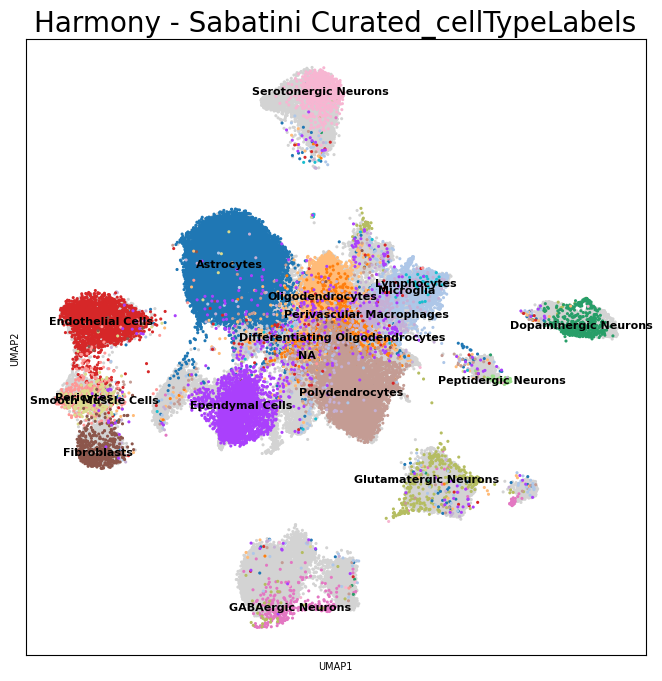

In [23]:
import matplotlib.pyplot as plt
# plt.rcParams.update({'font.size': 'large'})
fig,ax = plt.subplots(figsize=(8,8))
for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] +
             ax.get_xticklabels() + ax.get_yticklabels()):
    item.set_fontsize(7)
ax=sc.pl.umap(combine_adata, size = 20, color='Curated_cellTypeLabels',legend_loc='on data',
              legend_fontsize=8,ax=ax,show=False)
# sc.pl.umap(adata,size=4, color='sample',legend_fontweight=100,legend_fontsize =20,ax=ax,show=False)
ax.set_title('Harmony - Sabatini Curated_cellTypeLabels')
ax.title.set_fontsize(20)

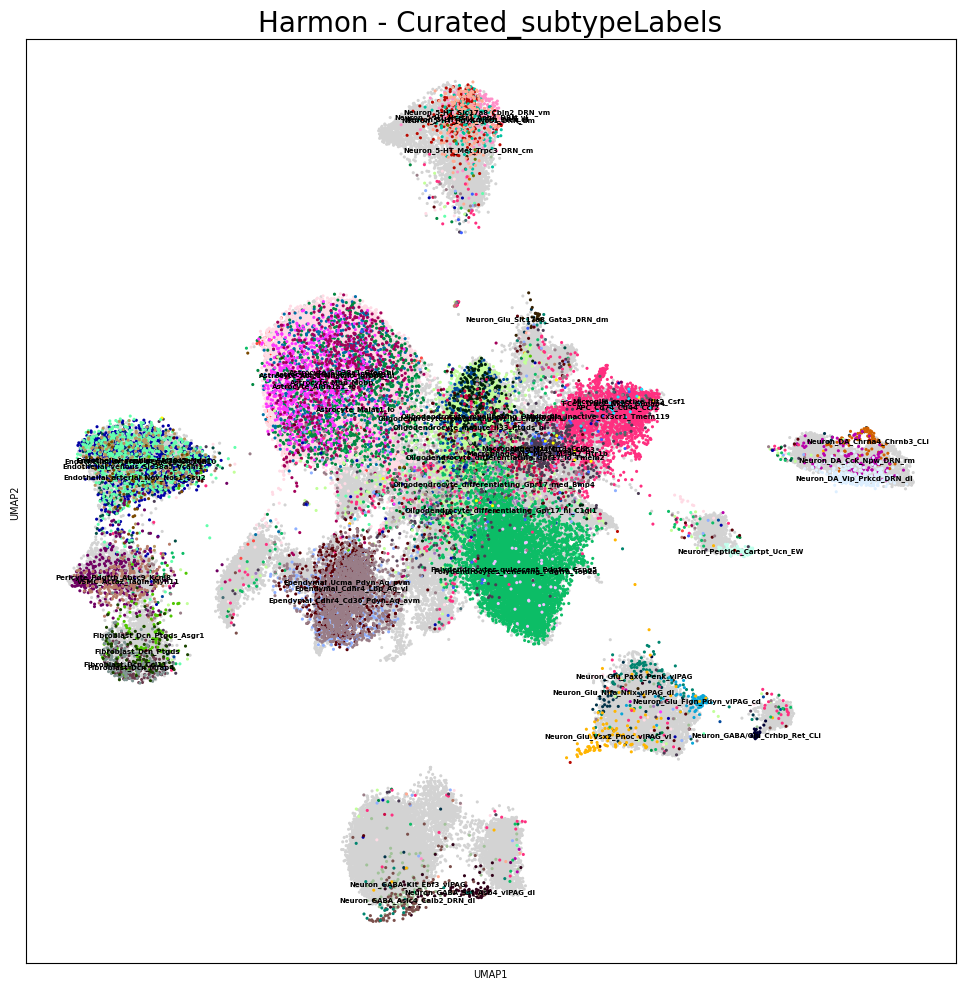

In [24]:
import matplotlib.pyplot as plt
# plt.rcParams.update({'font.size': 'large'})
fig,ax = plt.subplots(figsize=(12,12))
for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] +
             ax.get_xticklabels() + ax.get_yticklabels()):
    item.set_fontsize(7)
ax=sc.pl.umap(combine_adata, size = 20, color='Curated_subtypeLabels',legend_loc='on data',
              legend_fontsize=5,ax=ax,show=False, s = 20)
# sc.pl.umap(adata,size=4, color='sample',legend_fontweight=100,legend_fontsize =20,ax=ax,show=False)
ax.set_title('Harmon - Curated_subtypeLabels')
ax.title.set_fontsize(20)

CPU times: user 18min 41s, sys: 1min 50s, total: 20min 31s
Wall time: 1d 16h 45min 42s


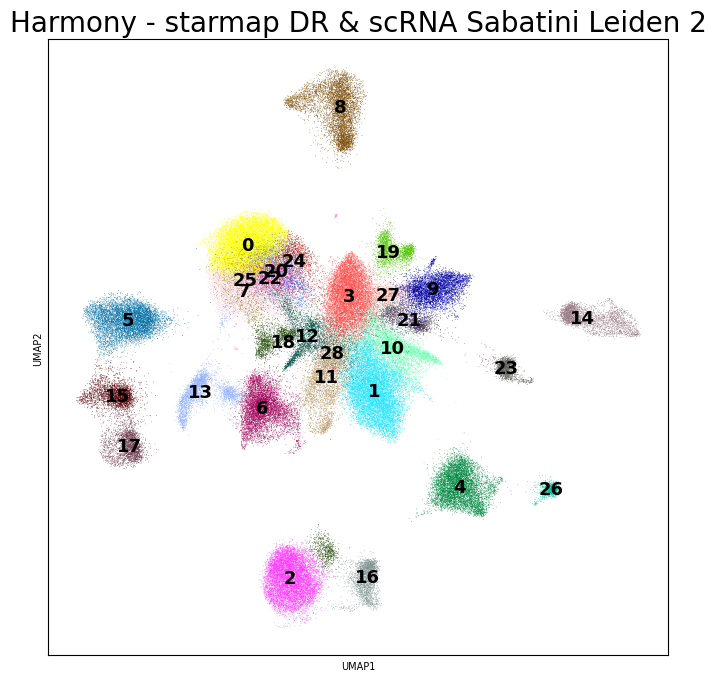

In [25]:
%%time
# Run louvain cluster
sc.tl.leiden(combine_adata, resolution = 2)

import matplotlib.pyplot as plt
# plt.rcParams.update({'font.size': 'large'})
fig,ax = plt.subplots(figsize=(8,8))
for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] +
             ax.get_xticklabels() + ax.get_yticklabels()):
    item.set_fontsize(7)
ax=sc.pl.umap(combine_adata, color='leiden',legend_loc='on data',legend_fontsize=13,ax=ax,show=False)
# sc.pl.umap(adata,size=4, color='sample',legend_fontweight=100,legend_fontsize =20,ax=ax,show=False)
ax.set_title('Harmony - starmap DR & scRNA Sabatini Leiden 2')
ax.title.set_fontsize(20)

combine_adata.obs['combine_leiden_res1']=combine_adata.obs['leiden']

In [ ]:
##After clustering, determine the spatial distribution of various clusters to identify cell-type identity

In [ ]:
import os
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm


samples = ['Sample1', 'Sample2', 'Sample3', 'Sample4', 'Sample5', 'Sample6', 'Sample7', 'Sample8']

# Get all unique leiden clusters
unique_leiden_clusters = sorted(combine_adata.obs['leiden'].unique())

# Define a color palette for the clusters
palette = sns.color_palette("Set2", len(unique_leiden_clusters))

# Iterate over each leiden cluster
for idx, leiden_cluster in enumerate(tqdm(unique_leiden_clusters)):
    # Create a figure with subplots
    fig, axs = plt.subplots(nrows=4, ncols=2, figsize=(13, 22))
    axs = axs.flatten()

    # Plot for each sample
    for i, sample in enumerate(samples):
        # Get dfs for the cells in the sample
        df_sample = combine_adata.obs.loc[combine_adata.obs['sample'] == sample, :]

        # Plot the gray cells (background)
        sns.scatterplot(x='x', y='y', data=df_sample, color='#D3D3D3', s=10, alpha=0.5, ax=axs[i], linewidth=0)

        # Get dfs for the cells in the specific leiden cluster and sample
        df_cluster = df_sample.loc[df_sample['leiden'] == leiden_cluster, :]

        # Overlay the colored cells for the current cluster and sample
        sns.scatterplot(x='x', y='y', data=df_cluster, color=palette[idx], s=30, ax=axs[i], linewidth=0)

        # Invert axes if needed, remove axis labels, set title
        axs[i].invert_xaxis()
        axs[i].axes.xaxis.set_visible(False)
        axs[i].axes.yaxis.set_visible(False)
        axs[i].set_title(f'Sample {sample} - Leiden {leiden_cluster}')

    # Adjust the layout
    plt.tight_layout()

    # Show the plot
    plt.show()


In [70]:
# backup 
combine_adata.write_h5ad(f"{out_path}/240128_FinalAnalyses_AllCells_Resolution2BeforeMerge.h5ad")

In [31]:
# load adata for combined STARmap and RIBOmap samples
combine_adata = sc.read_h5ad(os.path.join(out_path, '240128_FinalAnalyses_AllCells_Resolution2BeforeMerge.h5ad'))
combine_adata

AnnData object with n_obs × n_vars = 124483 × 227
    obs: 'sample', 'area', 'protocol', 'x', 'y', 'seg_label', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_5_genes', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'n_genes', 'n_counts', 'protocol-sample', 'nGene', 'nUMI', 'Reads', 'UMIFM', 'BatchID', 'Condition', 'orig.ident', 'Sex', 'percent.mito', 'var.ratio.pca', 'res.3', 'ClusterNumbers_cca.aligned_1.35_res_3', 'res.2', 'ClusterNumbers_cca.aligned_1.35_res_2', 'tree.ident', 'ClusterTreeNumbers_filtered', 'CellClassNames_filtered', 'Curated_subtypeLabels', 'Curated_cellTypeLabels', 'Curated_cellTypeLabels_ordered', 'batch', 'dataset', 'leiden', 'combine_leiden_res1'
    var: 'max_counts_sample1_STARmap-STAR-RIBOmap', 'max_counts_sample2_STARmap-STAR-RIBOmap', 'max_counts_sample3_STARmap-STAR-RIBOmap', 'max_counts_sample4_STARmap-STAR-RIBOmap', 'max_counts_sample5_RIBOmap-STAR-RIBO

In [32]:
combine_adata_st=combine_adata[combine_adata.obs['dataset']=='STAR-RIBOmap',:]

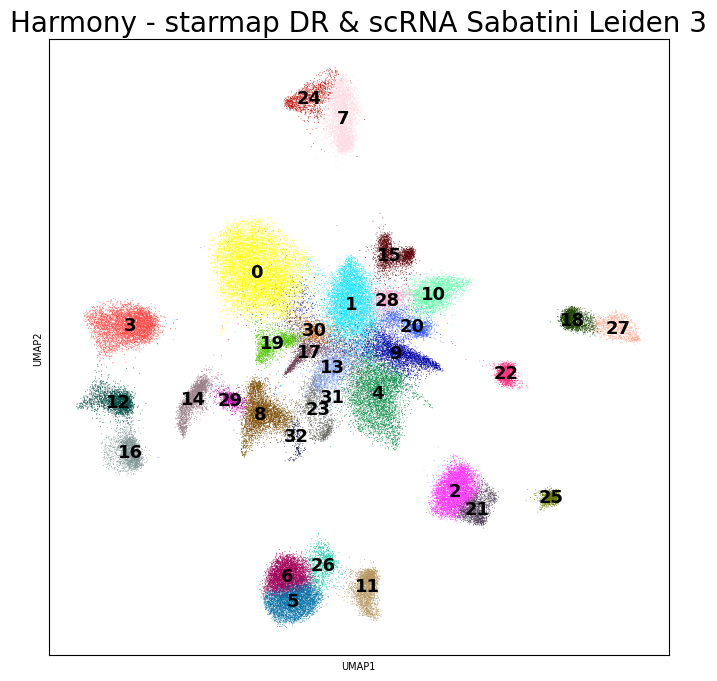

In [35]:
##clustering with only starmap ribomap cells
# Run louvain cluster
sc.tl.leiden(combine_adata_st, resolution = 3)

import matplotlib.pyplot as plt
# plt.rcParams.update({'font.size': 'large'})
fig,ax = plt.subplots(figsize=(8,8))
for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] +
             ax.get_xticklabels() + ax.get_yticklabels()):
    item.set_fontsize(7)
ax=sc.pl.umap(combine_adata_st, color='leiden',legend_loc='on data',legend_fontsize=13,ax=ax,show=False)
# sc.pl.umap(adata,size=4, color='sample',legend_fontweight=100,legend_fontsize =20,ax=ax,show=False)
ax.set_title('Harmony - starmap DR & scRNA Sabatini Leiden 3')
ax.title.set_fontsize(20)

In [ ]:
##Merge small over-clustered non-neuronal cells based on gene expression and spatial distribution


combine_adata_st.obs['leiden'][combine_adata_st.obs['leiden'].isin(['17'])]='22'
combine_adata_st.obs['leiden']=combine_adata_st.obs['leiden'].astype('str').astype('category')
### Reorder and rename the Leiden
combine_adata_st.obs['leiden'].cat.rename_categories(np.arange(len(np.unique(combine_adata_st.obs['leiden']))).astype('str'), inplace=True)



# Plot updated umap
fig,ax = plt.subplots(figsize=(8,8))
for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] +
             ax.get_xticklabels() + ax.get_yticklabels()):
    item.set_fontsize(7)
ax=sc.pl.umap(combine_adata_st, color='leiden',legend_loc='on data',legend_fontsize = 10, s = 10, ax=ax,show=False, add_outline = True)
# sc.pl.umap(adata,size=4, color='sample',legend_fontweight=100,legend_fontsize =20,ax=ax,show=False)
ax.set_title('testingclusters')
ax.title.set_fontsize(20)



In [72]:
# backup 
combine_adata_st.write_h5ad(f"{out_path}/240131_Allcells_AfterMergingLeiden.h5ad")

In [94]:
# load adata for STARmap combined
combine_adata_st = sc.read_h5ad(os.path.join(out_path, '240131_Allcells_AfterMergingLeiden.h5ad'))
combine_adata_st

AnnData object with n_obs × n_vars = 85072 × 227
    obs: 'sample', 'area', 'protocol', 'x', 'y', 'seg_label', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_5_genes', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'n_genes', 'n_counts', 'protocol-sample', 'nGene', 'nUMI', 'Reads', 'UMIFM', 'BatchID', 'Condition', 'orig.ident', 'Sex', 'percent.mito', 'var.ratio.pca', 'res.3', 'ClusterNumbers_cca.aligned_1.35_res_3', 'res.2', 'ClusterNumbers_cca.aligned_1.35_res_2', 'tree.ident', 'ClusterTreeNumbers_filtered', 'CellClassNames_filtered', 'Curated_subtypeLabels', 'Curated_cellTypeLabels', 'Curated_cellTypeLabels_ordered', 'batch', 'dataset', 'leiden', 'combine_leiden_res1'
    var: 'max_counts_sample1_STARmap-STAR-RIBOmap', 'max_counts_sample2_STARmap-STAR-RIBOmap', 'max_counts_sample3_STARmap-STAR-RIBOmap', 'max_counts_sample4_STARmap-STAR-RIBOmap', 'max_counts_sample5_RIBOmap-STAR-RIBOm

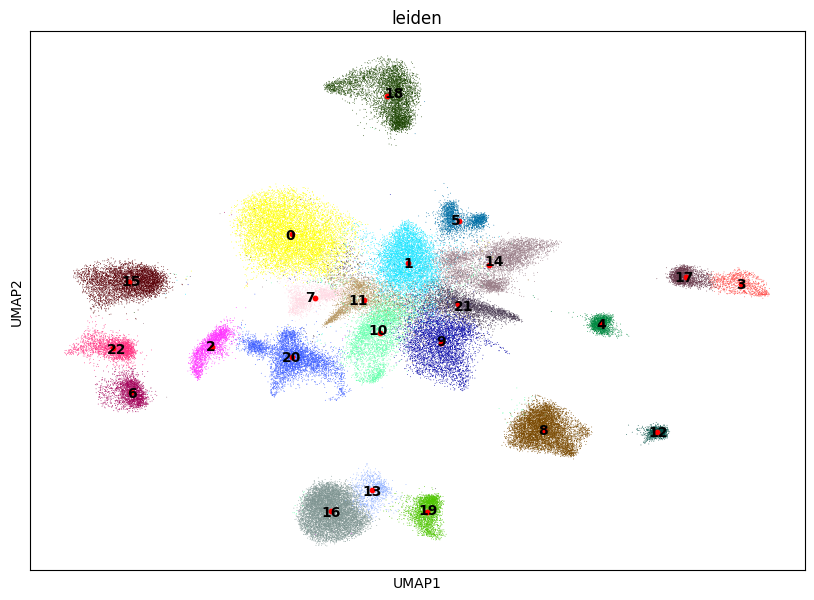

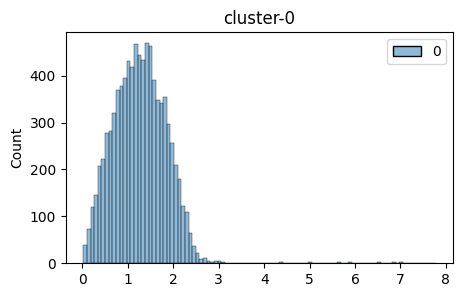

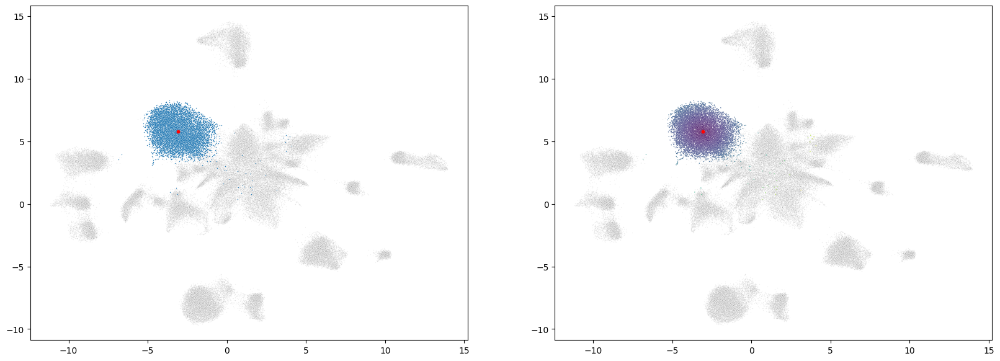

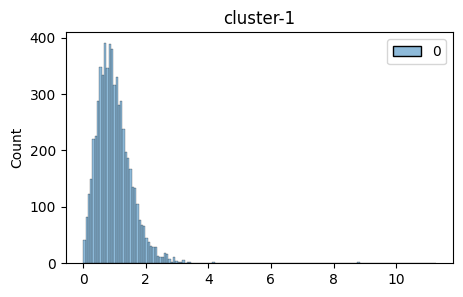

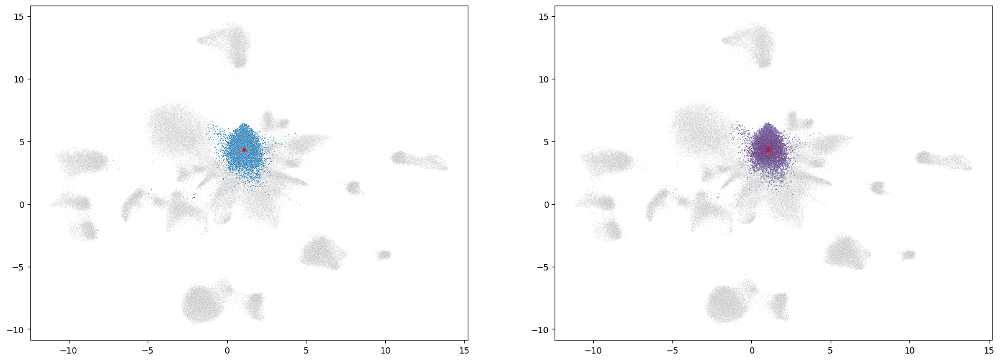

...

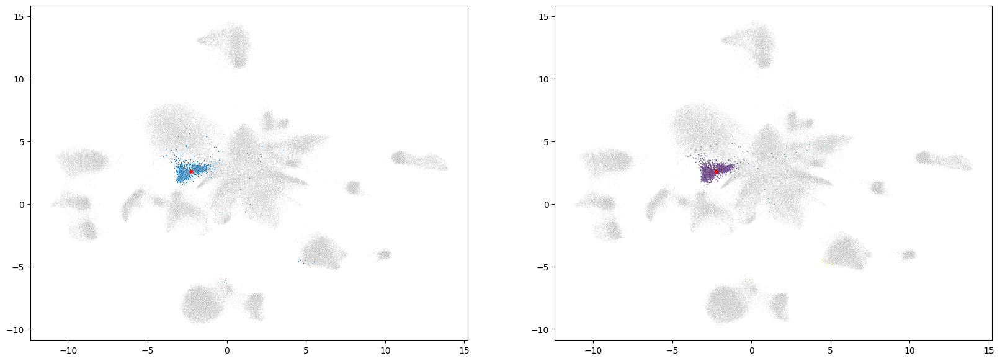

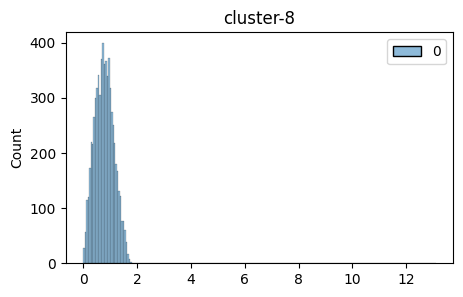

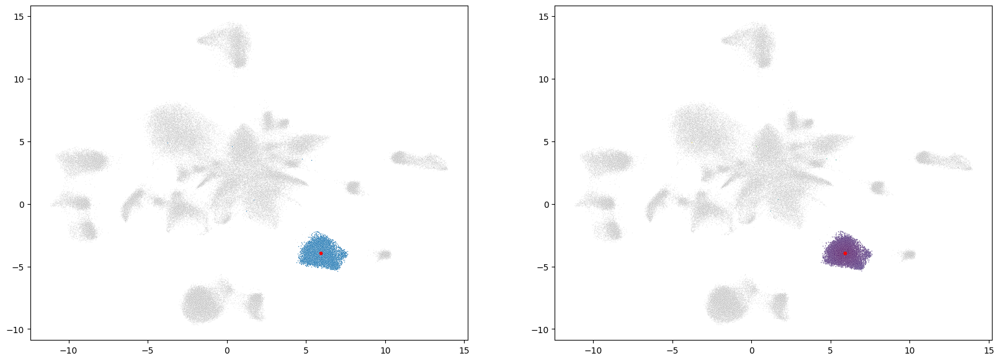

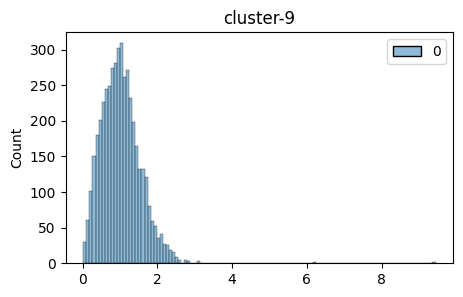

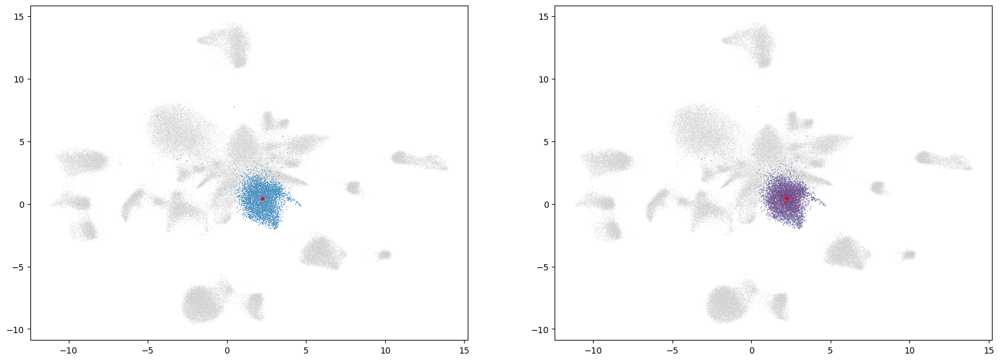

In [95]:
##Classify mix cells

# calculate the distance between each cell and its leiden cluster center
combine_adata_st.obs['distance2centroid_leiden'] = 9999

# find centroid of each leiden cluster
from sklearn.neighbors import NearestCentroid
from scipy.spatial.distance import cdist
clf = NearestCentroid(shrink_threshold=None)
clf.fit(combine_adata_st.obsm['X_umap'], combine_adata_st.obs.leiden)

# plot cluster center
fig, ax = plt.subplots(figsize=(10,7))
sc.pl.umap(combine_adata_st, color='leiden', ax=ax, show=False, legend_loc='on data')
ax.scatter(clf.centroids_[:, 0], clf.centroids_[:, 1], s=10, c='r')
plt.show()

for i, current_label in enumerate(sorted(combine_adata_st.obs['leiden'].cat.categories)):
    current_centroid = clf.centroids_[i, :].reshape([1,2])
    
    # check centroid location 
    # fig, ax = plt.subplots(figsize=(10,7))
    # sc.pl.umap(adata, color='leiden', ax=ax, show=False, legend_loc='on data', title=f'cluster-{current_label}')
    # ax.scatter(current_centroid[:, 0], current_centroid[:, 1], s=10, c='r')
    # plt.show()

    # calculate distance 
    dm = cdist(combine_adata_st[combine_adata_st.obs['leiden'] == current_label, :].obsm['X_umap'], current_centroid)
    combine_adata_st.obs.loc[combine_adata_st.obs['leiden'] == current_label, 'distance2centroid_leiden'] = dm

    # plot distance distribution
    fig, ax = plt.subplots(figsize=(5,3))
    sns.histplot(dm)
    plt.title(f'cluster-{current_label}')
    plt.show()
    
    # visualize distance calculation 
    fig, axs = plt.subplots(figsize=(20,7), nrows=1, ncols=2)
    sns.scatterplot(combine_adata_st.obsm['X_umap'][:, 0], combine_adata_st.obsm['X_umap'][:, 1], color='#1111', s=1, ax=axs[0])
    sns.scatterplot(combine_adata_st[combine_adata_st.obs['leiden'] == current_label, :].obsm['X_umap'][:, 0], combine_adata_st[combine_adata_st.obs['leiden'] == current_label, :].obsm['X_umap'][:, 1], s=1, legend=None, ax=axs[0])
    axs[0].scatter(current_centroid[:, 0], current_centroid[:, 1], s=10, c='r')

    sns.scatterplot(combine_adata_st.obsm['X_umap'][:, 0], combine_adata_st.obsm['X_umap'][:, 1], color='#1111', s=1, ax=axs[1])
    sns.scatterplot(combine_adata_st[combine_adata_st.obs['leiden'] == current_label, :].obsm['X_umap'][:, 0], combine_adata_st[combine_adata_st.obs['leiden'] == current_label, :].obsm['X_umap'][:, 1], 
                    hue=combine_adata_st.obs.loc[combine_adata_st.obs['leiden'] == current_label, 'distance2centroid_leiden'], palette='viridis', s=1, legend=None, ax=axs[1])
    axs[1].scatter(current_centroid[:, 0], current_centroid[:, 1], s=10, c='r')
    plt.show()


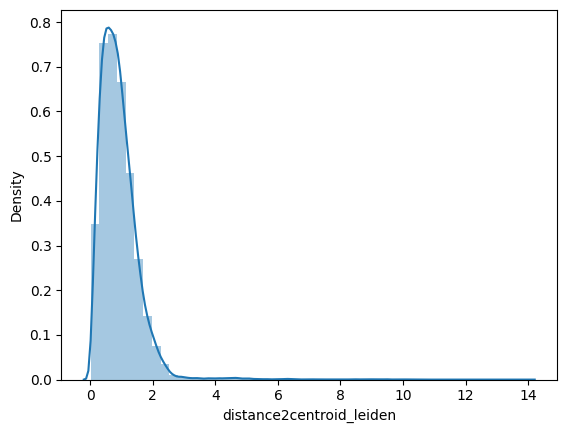

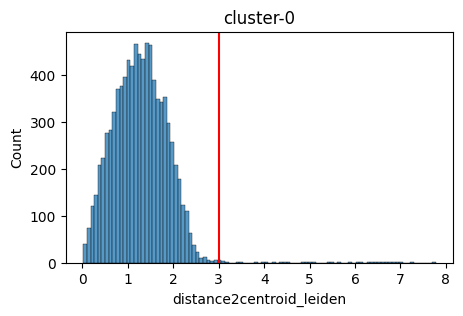

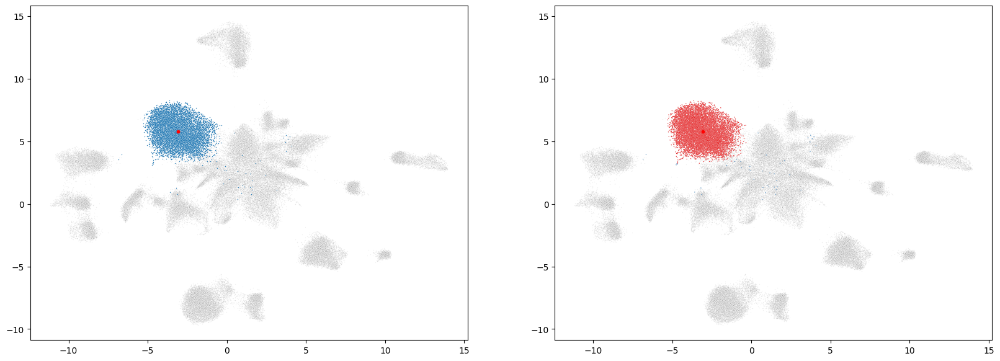

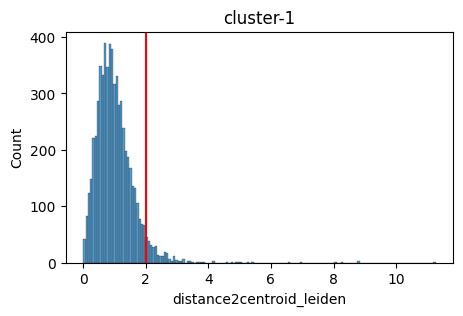

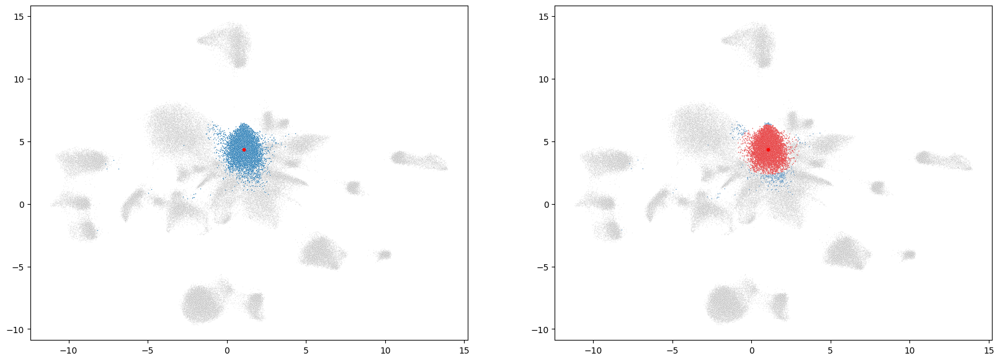

...

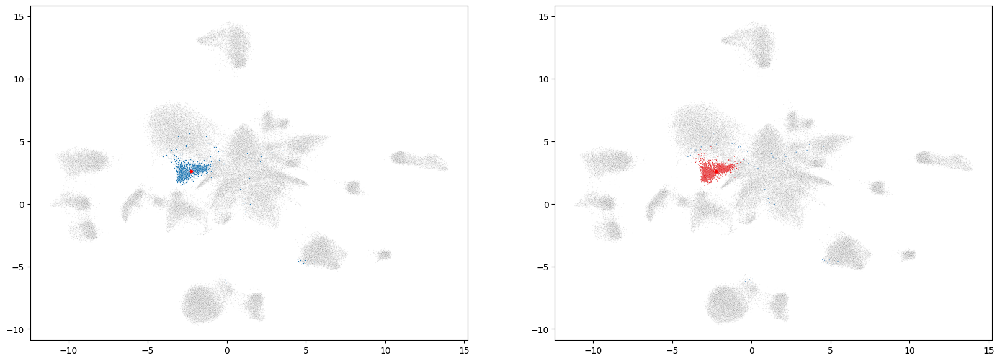

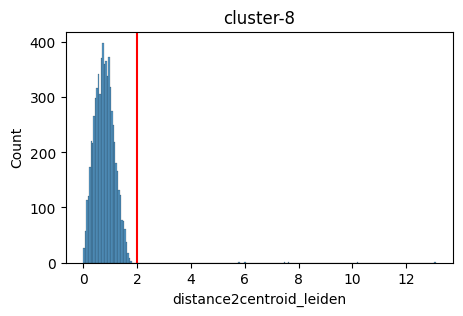

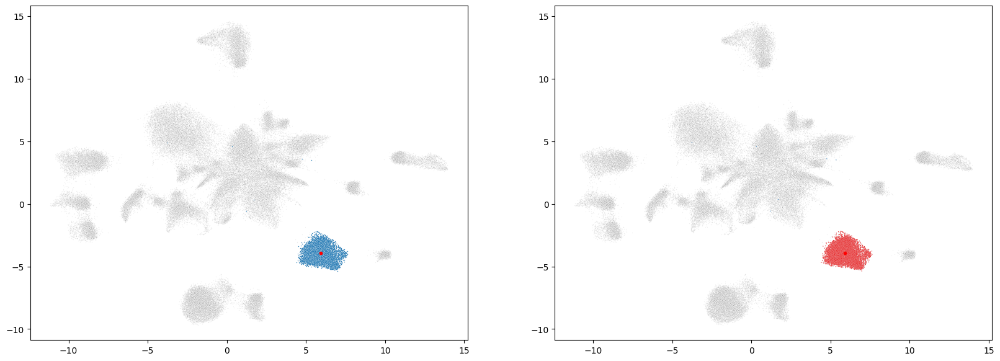

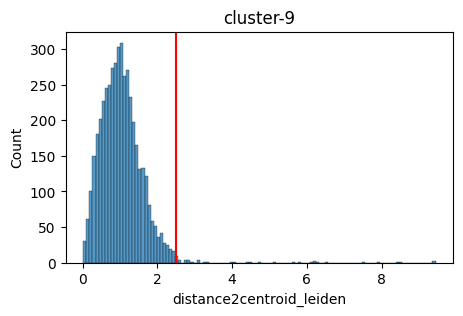

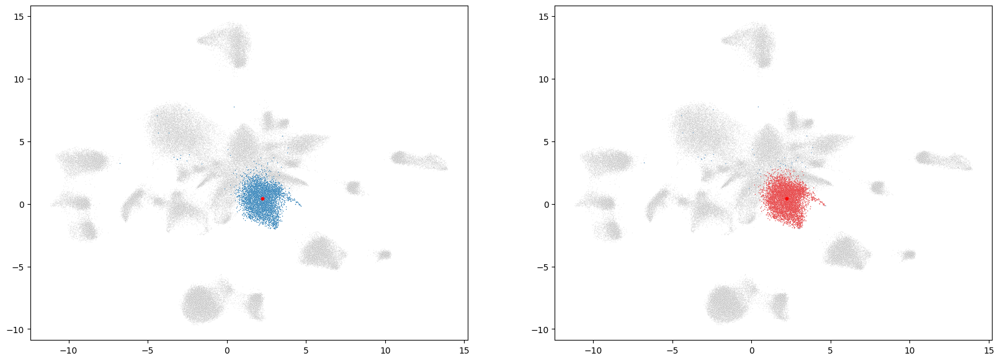

In [98]:
# classify mix cells 
manual_threshold = [
    3, # 0
    2, # 1
    2.5, # 10
    2, # 11
    2, # 12
    2, # 13
    2.2, # 14
    3, # 15
    2.5, # 16
    0, # 17
    3, # 18
    2, # 19
    2, # 2
    2, # 20
    2.2, # 21
    2, #22
    2, # 3
    2, # 4
    2, # 5
    2, # 6
    2, # 7
    2, # 8
    2.5, # 9
]


combine_adata_st.obs['is_mix'] = 'False'

# plot overall distance distribution
sns.distplot(combine_adata_st.obs['distance2centroid_leiden'])

for i, current_label in enumerate(sorted(combine_adata_st.obs['leiden'].cat.categories)):
    current_centroid = clf.centroids_[i, :].reshape([1,2])
    
    # plot distance distribution of current cluster
    fig, ax = plt.subplots(figsize=(5,3))
    sns.histplot(combine_adata_st.obs.loc[combine_adata_st.obs['leiden'] == current_label, 'distance2centroid_leiden'])
    ax.axvline(x=manual_threshold[i], c='r')
    plt.title(f'cluster-{current_label}')
    plt.show()
    
    combine_adata_st.obs.loc[(combine_adata_st.obs['leiden'] == current_label) & (combine_adata_st.obs['distance2centroid_leiden'] > manual_threshold[i]), 'is_mix'] = 'True'
    combine_adata_st.obs['is_mix'] = combine_adata_st.obs['is_mix'].astype('category')
    
    fig, axs = plt.subplots(figsize=(20,7), nrows=1, ncols=2)
    sns.scatterplot(combine_adata_st.obsm['X_umap'][:, 0], combine_adata_st.obsm['X_umap'][:, 1], color='#1111', s=1, ax=axs[0])
    sns.scatterplot(combine_adata_st[combine_adata_st.obs['leiden'] == current_label, :].obsm['X_umap'][:, 0], combine_adata_st[combine_adata_st.obs['leiden'] == current_label, :].obsm['X_umap'][:, 1], s=1, legend=None, ax=axs[0])
    axs[0].scatter(current_centroid[0, 0], current_centroid[0, 1], s=10, c='r')

    sns.scatterplot(combine_adata_st.obsm['X_umap'][:, 0], combine_adata_st.obsm['X_umap'][:, 1], color='#1111', s=1, ax=axs[1])
    sns.scatterplot(combine_adata_st[combine_adata_st.obs['leiden'] == current_label, :].obsm['X_umap'][:, 0], combine_adata_st[combine_adata_st.obs['leiden'] == current_label, :].obsm['X_umap'][:, 1], 
                    hue=combine_adata_st.obs.loc[combine_adata_st.obs['leiden'] == current_label, 'is_mix'], palette='Set1', s=1, legend=None, ax=axs[1])
    axs[1].scatter(current_centroid[0, 0], current_centroid[0, 1], s=10, c='r')

In [138]:
# create backup for leiden label
combine_adata_st.obs['orig_leiden'] = combine_adata_st.obs['leiden'].values

combine_adata_st.obs['level_1'] = combine_adata_st.obs['leiden'].values
combine_adata_st.obs['level_2'] = combine_adata_st.obs['leiden'].values
combine_adata_st.obs['level_3'] = combine_adata_st.obs['leiden'].values

In [139]:
# Change cluster label to cell type label
transfer_dict_l1 = {}
transfer_dict_l2 = {}
transfer_dict_l3 = {}

# Level_1
level_1_list = [
    'None DRN Neuron', #0
    'None DRN Neuron', #1
    'DRN Neuron', #2
    'DRN Neuron', #3
    'None DRN Neuron', #4
    'DRN Neuron', #5
    'None DRN Neuron', #6
    'None DRN Neuron', #7
    'DRN Neuron', #8
    'None DRN Neuron', #9
    'None DRN Neuron', #10
    'None DRN Neuron', #11
    'DRN Neuron', #12
    'DRN Neuron', #13
    'None DRN Neuron', #14
    'None DRN Neuron', #15
    'DRN Neuron', #16
    'None DRN Neuron', #17
    'DRN Neuron', #18
    'DRN Neuron', #19
    'None DRN Neuron', #20
    'DRN Neuron', #21
    'None DRN Neuron', #22
]


# Level_2
level_2_list = [
    'Astrocytes', #0
    'Oligodendrocytes', #1
    'GABA', #2
    'Dopaminergic', #3
    'Peptidergic - None DR', #4
    'Glu', #5
    'Fibroblasts', #6
    'None DRN', #7
    'Glu', #8
    'Polydendrocytes', #9
    'None DRN', #10
    'None DRN', #11
    'GABA_Glu', #12
    'GABA', #13
    'Lymphocytes', #14
    'Endothelial', #15
    'GABA', #16
    'Mix', #17
    'Serotonergic', #18
    'GABA', #19
    'Endodymal', #20
    'vlPAG', #21
    'Pericytes', #22
]


# Level_3
level_3_list = [
    'Astrocytes', #0
    'Oligodendrocytes', #1
    'GABA3', #2
    'Dopaminergic', #3
    'Peptidergic - None DR', #4
    'Glu2', #5
    'Fibroblasts', #6
    'None DRN', #7
    'Glu1', #8
    'Polydendrocytes', #9
    'None DRN', #10
    'None DRN', #11
    'GABA_Glu', #12
    'GABA4', #13
    'Lymphocytes', #14
    'Endothelial', #15
    'GABA1', #16
    'Mix', #17
    'Serotonergic', #18
    'GABA2', #19
    'Endodymal', #20
    'vlPAG', #21
    'Pericytes', #22
]

# construct transfer dict
for i in sorted(combine_adata_st.obs['leiden'].unique()):
    transfer_dict_l1[i] = level_1_list[int(i)]
    transfer_dict_l2[i] = level_2_list[int(i)]
    transfer_dict_l3[i] = level_3_list[int(i)]

In [140]:
# Assign cell type to sdata
combine_adata_st.obs = combine_adata_st.obs.replace({'level_1': transfer_dict_l1})
combine_adata_st.obs = combine_adata_st.obs.replace({'level_2': transfer_dict_l2})
combine_adata_st.obs = combine_adata_st.obs.replace({'level_3': transfer_dict_l3})

In [337]:
# backup 
combine_adata_st.write_h5ad(f"{out_path}/240131_Allcells_annotatedinlevel.h5ad")

In [142]:
combine_adata_st.obs['level_2'].unique()

['Peptidergic - None DR', 'Astrocytes', 'None DRN', 'Oligodendrocytes', 'Glu', ..., 'Serotonergic', 'Fibroblasts', 'GABA_Glu', 'vlPAG', 'Dopaminergic']
Length: 17
Categories (17, object): ['Astrocytes', 'Oligodendrocytes', 'Dopaminergic', 'Peptidergic - None DR', ..., 'Serotonergic', 'Endodymal', 'vlPAG', 'Pericytes']

In [144]:
combine_adata_st.obs['level_1'] = combine_adata_st.obs['level_1'].astype(object)
combine_adata_st.obs['level_2'] = combine_adata_st.obs['level_2'].astype(object)
combine_adata_st.obs['level_3'] = combine_adata_st.obs['level_3'].astype(object)

combine_adata_st.obs.loc[combine_adata_st.obs['is_mix'] == 'True', 'level_1'] = 'Mix'
combine_adata_st.obs.loc[combine_adata_st.obs['is_mix'] == 'True', 'level_2'] = 'Mix'
combine_adata_st.obs.loc[combine_adata_st.obs['is_mix'] == 'True', 'level_3'] = 'Mix'

In [145]:
# Sort category
level_1_order = ['DRN Neuron', 'None DRN Neuron', 'Mix']
level_2_order = ['Dopaminergic', #0
                 'Serotonergic', #1 
                 'GABA', #2
                 'Glu', #3
                 'GABA_Glu', #4
                 'vlPAG', #5
                 'Peptidergic - None DR', #6
                 'Astrocytes', #7
                 'Oligodendrocytes', #8
                 'Fibroblasts', #9
                 'Polydendrocytes', #10   
                 'Lymphocytes', #11
                 'Endothelial', #12
                 'Endodymal', #13
                 'Pericytes', #14
                 'Mix', #15
                 'None DRN' #16
]

combine_adata_st.obs['level_1'] = combine_adata_st.obs['level_1'].astype('category')
combine_adata_st.obs['level_1'].cat.reorder_categories(level_1_order, inplace=True)

combine_adata_st.obs['level_2'] = combine_adata_st.obs['level_2'].astype('category')
combine_adata_st.obs['level_2'].cat.reorder_categories(level_2_order, inplace=True)

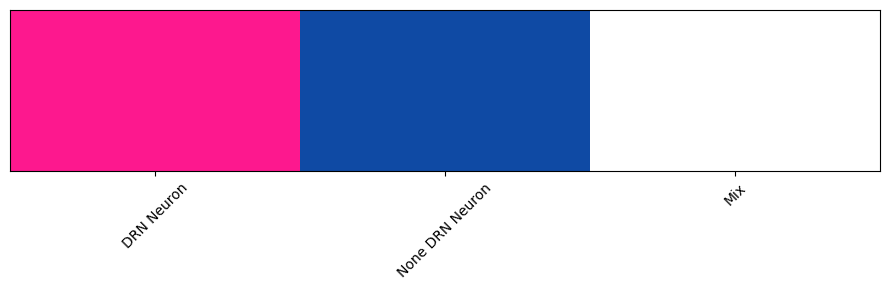

In [190]:
# Check color legend
level_1_pl = sns.color_palette(['#FD188E', '#0F4AA4', '#FFFFFF'])
sns.palplot(level_1_pl, size=3)
plt.xticks(range(len(level_1_order)), level_1_order, size=10, rotation=45)
plt.tight_layout()
# plt.savefig(f'./figures/color_legend_top.png')
plt.show()

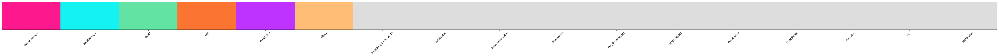

In [277]:
# Check color legend (old coloring scheme)
level_2_colors2 = ['#FD188E', #Dopaminergic
                  '#14F2F2', #Serotonergic
                  '#62E3A4', #GABA
                  '#FC7431', #Glu
                  '#BE33FF', #GABA_Glu
                  '#FFBD76', #vlPAG
                  '#DDDDDD', #Peptidergic - None DR
                  '#DDDDDD', #Astrocytes
                  '#DDDDDD', #8Oligodendrocytes
                  '#DDDDDD', #9Fibroblasts
                  '#DDDDDD', #10   Polydendrocytes
                  '#DDDDDD', #11Lymphocytes
                  '#DDDDDD', #12Endothelial
                  '#DDDDDD', #13Endodymal
                  '#DDDDDD', #14Pericytes
                  '#DDDDDD', #15Mix
                  '#DDDDDD' #16 None DRN
                 ]
level_2_pl2 = sns.color_palette(level_2_colors2)
sns.palplot(level_2_pl2, size=3)
plt.xticks(range(len(level_2_order)), level_2_order, size=10, rotation=45)
plt.tight_layout()
# plt.savefig(f'./figures/color_legend_top.png')
plt.show()

combine_adata_st.obs['level_2'] = combine_adata_st.obs['level_2'].cat.reorder_categories(level_2_order)

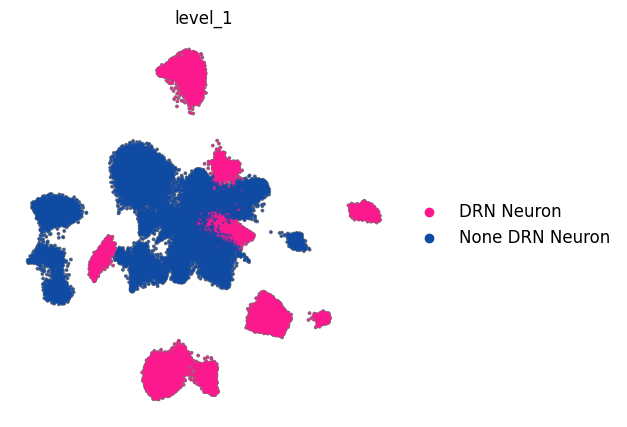

In [215]:
plt.rcParams['figure.figsize'] = (5, 5)  # Width, Height in inches

# Your existing code
non_mix_cells = combine_adata_st[combine_adata_st.obs['level_1'] != 'Mix']
sc.pl.umap(non_mix_cells, color='level_1', legend_loc='right margin',
           legend_fontsize=12, legend_fontoutline=2, frameon=False, palette=level_1_pl, s=15, 
           save='240130_allcells_NeuronNoneNeuron.pdf', 
           add_outline=True, outline_color=('#7C7C7C', '#7C7C7C'), outline_width=(0.1, 0.1))


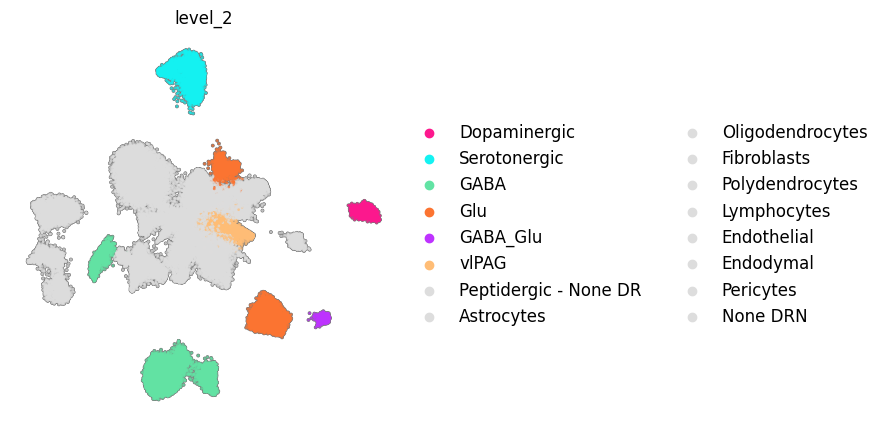

In [278]:
plt.rcParams['figure.figsize'] = (5, 5)  # Width, Height in inches

# Your existing code
non_mix_cells = combine_adata_st[combine_adata_st.obs['level_2'] != 'Mix']
sc.pl.umap(non_mix_cells, color='level_2', legend_loc='right margin',
           legend_fontsize=12, legend_fontoutline=2, frameon=False, palette=level_2_pl2, s=15, save='240130_allcells_umap2.pdf',  
           add_outline=True, outline_color=('#7C7C7C', '#7C7C7C'), outline_width=(0.1, 0.1))


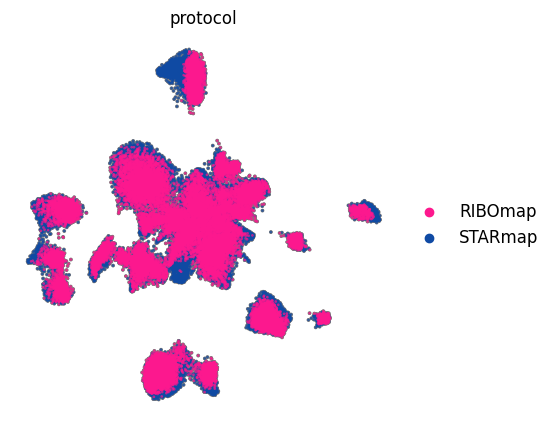

In [263]:
plt.rcParams['figure.figsize'] = (5, 5)  # Width, Height in inches

# Your existing code
non_mix_cells = combine_adata_st[combine_adata_st.obs['level_2'] != 'Mix']
sc.pl.umap(non_mix_cells, color='protocol', legend_loc='right margin',
           legend_fontsize=12, legend_fontoutline=2, frameon=False, palette=level_1_pl, s=15, save='240130_allcells_starribomap.pdf',  
           add_outline=True, outline_color=('#7C7C7C', '#7C7C7C'), outline_width=(0.1, 0.1))


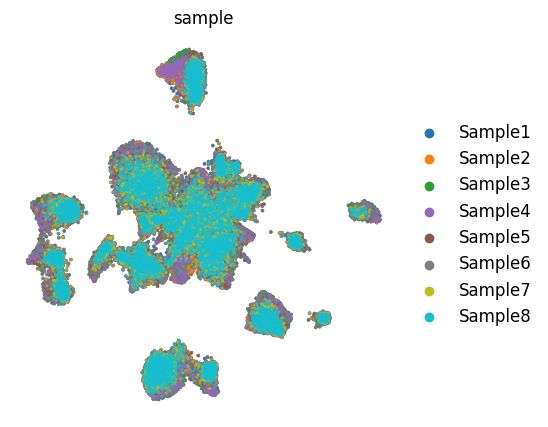

In [271]:
plt.rcParams['figure.figsize'] = (5, 5)  # Width, Height in inches

# Your existing code
non_mix_cells = combine_adata_st[combine_adata_st.obs['level_2'] != 'Mix']
sc.pl.umap(non_mix_cells, color='sample', legend_loc='right margin',
           legend_fontsize=12, legend_fontoutline=2, frameon=False, palette= 'tab10', s=15, save = '240131_allcells_sampledistribution.pdf',  
           add_outline=True, outline_color=('#7C7C7C', '#7C7C7C'), outline_width=(0.1, 0.1))


In [356]:
# backup 
combine_adata_st.write_h5ad(f"{out_path}/240201_allcells_FinalDataBackup.h5ad")

# Generating neuronal adata

In [359]:
# load adata for combined STARmap and RIBOmap samples
adata = sc.read_h5ad(os.path.join(out_path, '2023-11-30-Nectow-Lab-combined-HARMONY.h5ad'))
adata

AnnData object with n_obs × n_vars = 85072 × 256
    obs: 'sample', 'area', 'protocol', 'x', 'y', 'seg_label', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_5_genes', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'n_genes', 'n_counts', 'protocol-sample'
    var: 'max_counts_sample1_STARmap', 'max_counts_sample2_STARmap', 'max_counts_sample3_STARmap', 'max_counts_sample4_STARmap', 'max_counts_sample5_RIBOmap', 'max_counts_sample6_RIBOmap', 'max_counts_sample7_RIBOmap', 'max_counts_sample8_RIBOmap', 'detected', 'highly_variable', 'mean', 'std'
    uns: 'log1p', 'neighbors', 'pca', 'protocol-sample_colors', 'protocol_colors', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'combat', 'corrected', 'raw', 'scaled'
    obsp: 'connectivities', 'distances'

In [364]:
# Find cells marked as "DRN" in 'final_rank'
drn_cells = combine_adata_st.obs[combine_adata_st.obs['level_1'] == 'DRN Neuron'].index
drn_cells_adjusted = [cell.split('-')[0] for cell in drn_cells]
adata_neuron_only = adata[drn_cells_adjusted].copy()

In [366]:
# backup 
adata_neuron_only.write_h5ad(f"{out_path}/240201_NeuronsOnly_OriginalSubsetted.h5ad")

In [4]:
# load adata for combined STARmap and RIBOmap samples
adata_neuron = sc.read_h5ad(os.path.join(out_path, '240201_NeuronsOnly_OriginalSubsetted.h5ad'))
adata_neuron

AnnData object with n_obs × n_vars = 33591 × 256
    obs: 'sample', 'area', 'protocol', 'x', 'y', 'seg_label', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_5_genes', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'n_genes', 'n_counts', 'protocol-sample'
    var: 'max_counts_sample1_STARmap', 'max_counts_sample2_STARmap', 'max_counts_sample3_STARmap', 'max_counts_sample4_STARmap', 'max_counts_sample5_RIBOmap', 'max_counts_sample6_RIBOmap', 'max_counts_sample7_RIBOmap', 'max_counts_sample8_RIBOmap', 'detected', 'highly_variable', 'mean', 'std'
    uns: 'log1p', 'neighbors', 'pca', 'protocol-sample_colors', 'protocol_colors', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'combat', 'corrected', 'raw', 'scaled'
    obsp: 'connectivities', 'distances'

In [5]:
# load adata for Sabatini dataset - got this from Hailing, who integrated the individual Sabatini R objects into a single h5ad file
adata_sc = sc.read_h5ad(os.path.join(out_path, '240121-SabatiniNeuronsOnly.h5ad'))
adata_sc

AnnData object with n_obs × n_vars = 2041 × 17138
    obs: 'nGene', 'nUMI', 'Reads', 'UMIFM', 'BatchID', 'Condition', 'orig.ident', 'Sex', 'percent.mito', 'var.ratio.pca', 'res.3', 'ClusterNumbers_cca.aligned_1.35_res_3', 'res.2', 'ClusterNumbers_cca.aligned_1.35_res_2', 'tree.ident', 'ClusterTreeNumbers_filtered', 'CellClassNames_filtered', 'Curated_subtypeLabels', 'Curated_cellTypeLabels', 'Curated_cellTypeLabels_ordered', 'batch'

In [609]:
genes_sc = adata_sc.var_names
print(genes_sc.shape)
genes_star = adata_neuron.var_names
print(genes_star.shape)

(17138,)
(256,)


In [611]:
# Find the overlapping genes between the two datasets
overlapping_genes = np.intersect1d(genes_sc, genes_star)
print(overlapping_genes.shape)

adata_sc_subset = adata_sc[:, overlapping_genes]
adata_1006_subset = adata_neuron[:, overlapping_genes]

(227,)


In [612]:
# Normalization scaling sc
sc.pp.normalize_total(adata_sc_subset)
sc.pp.log1p(adata_sc_subset)


# Calculate QC metrics - sc
sc.pp.calculate_qc_metrics(adata_sc_subset, percent_top=None, inplace=True)


# Scale data to unit variance and zero mean - sc
sc.pp.regress_out(adata_sc_subset, ['total_counts'])
sc.pp.scale(adata_sc_subset)

In [613]:
##Generating the combined dataset

combine_adata=adata_1006_subset.concatenate(adata_sc_subset,batch_key='dataset', batch_categories=['STAR-RIBOmap','scrna-Sabatini'])

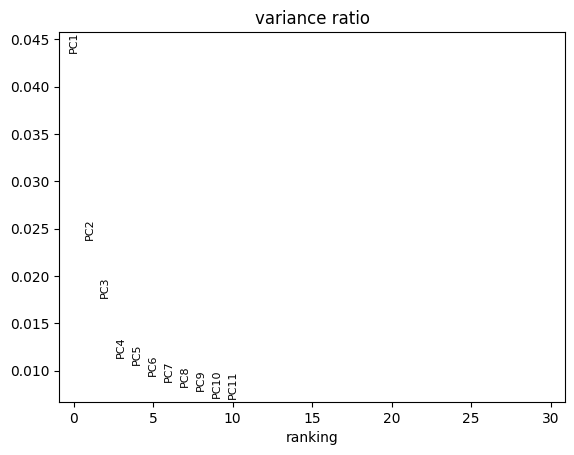

In [13]:
##PCA and umap in the next steps

sc.tl.pca(combine_adata,n_comps=11)
sc.pl.pca_variance_ratio(combine_adata)

In [14]:
import scanpy.external as sce
sce.pp.harmony_integrate(combine_adata, 'dataset')

2024-02-01 06:50:03,171 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-02-01 06:50:08,016 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-02-01 06:50:08,240 - harmonypy - INFO - Iteration 1 of 10
2024-02-01 06:50:19,343 - harmonypy - INFO - Iteration 2 of 10
2024-02-01 06:50:30,290 - harmonypy - INFO - Iteration 3 of 10
2024-02-01 06:50:40,993 - harmonypy - INFO - Iteration 4 of 10
2024-02-01 06:50:51,501 - harmonypy - INFO - Iteration 5 of 10
2024-02-01 06:51:01,849 - harmonypy - INFO - Iteration 6 of 10
2024-02-01 06:51:12,244 - harmonypy - INFO - Converged after 6 iterations


In [15]:

sc.pp.neighbors(combine_adata,n_neighbors=50,use_rep='X_pca_harmony')

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


In [16]:
sc.tl.umap(combine_adata)

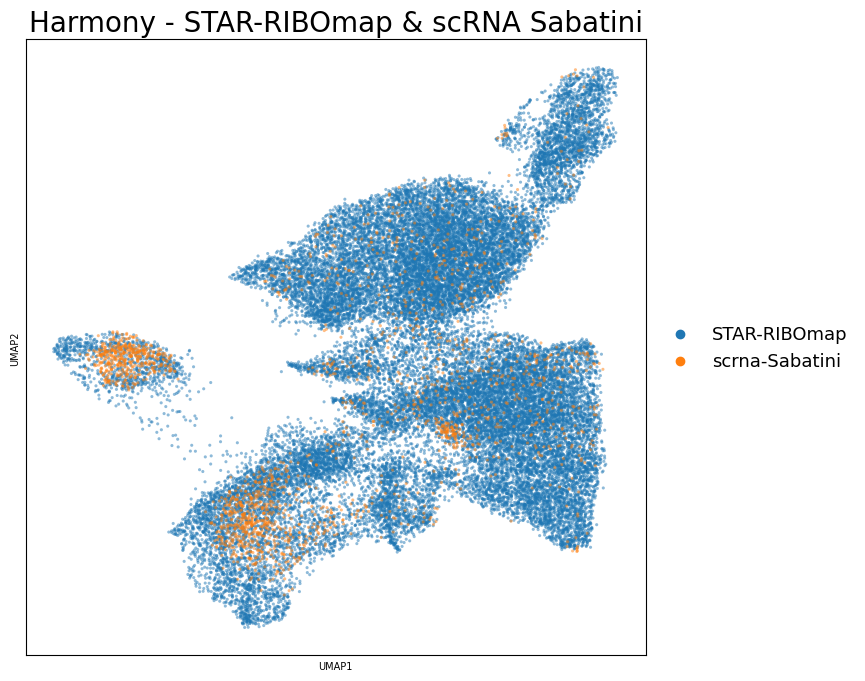

In [17]:

import matplotlib.pyplot as plt
# plt.rcParams.update({'font.size': 'large'})
fig,ax = plt.subplots(figsize=(8,8))
for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] +
             ax.get_xticklabels() + ax.get_yticklabels()):
    item.set_fontsize(7)
ax=sc.pl.umap(combine_adata, color='dataset',alpha = 0.5, legend_fontsize=13,ax=ax,s = 20, show=False)
# sc.pl.umap(adata,size=4, color='sample',legend_fontweight=100,legend_fontsize =20,ax=ax,show=False)
ax.set_title('Harmony - STAR-RIBOmap & scRNA Sabatini')
ax.title.set_fontsize(20)

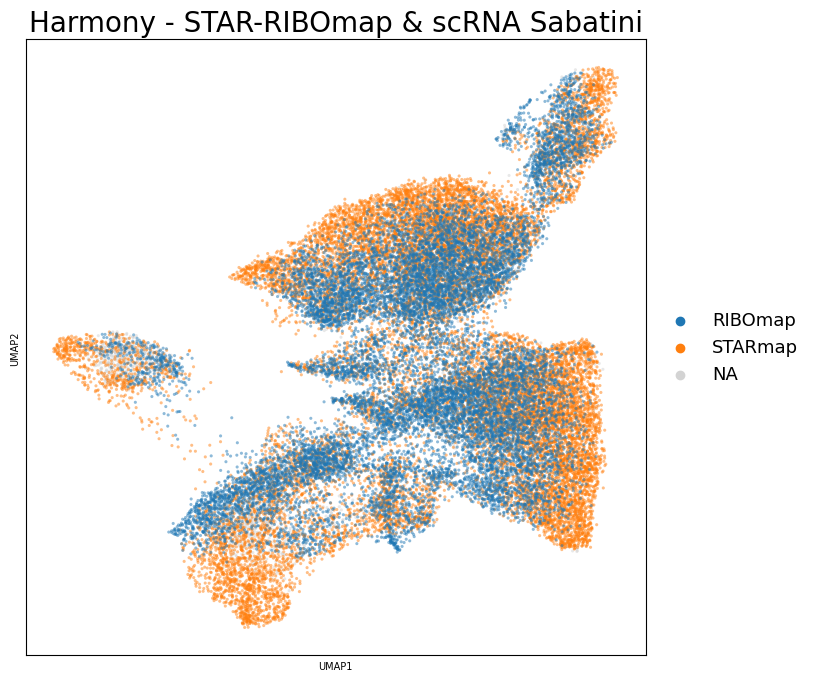

In [18]:

import matplotlib.pyplot as plt
# plt.rcParams.update({'font.size': 'large'})
fig,ax = plt.subplots(figsize=(8,8))
for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] +
             ax.get_xticklabels() + ax.get_yticklabels()):
    item.set_fontsize(7)
ax=sc.pl.umap(combine_adata, color='protocol',alpha = 0.5, legend_fontsize=13,ax=ax,s = 20, show=False)
# sc.pl.umap(adata,size=4, color='sample',legend_fontweight=100,legend_fontsize =20,ax=ax,show=False)
ax.set_title('Harmony - STAR-RIBOmap & scRNA Sabatini')
ax.title.set_fontsize(20)

In [24]:
combine_adata_st=combine_adata[combine_adata.obs['dataset']=='STAR-RIBOmap',:]

CPU times: user 1min 15s, sys: 2.3 s, total: 1min 18s
Wall time: 1min 18s


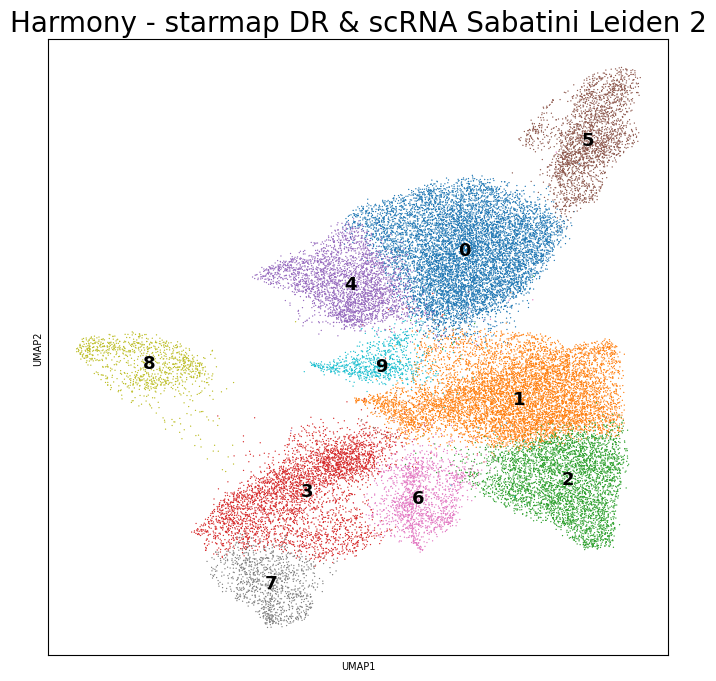

In [25]:
%%time
# Run louvain cluster
sc.tl.leiden(combine_adata_st, resolution = 0.6)

import matplotlib.pyplot as plt
# plt.rcParams.update({'font.size': 'large'})
fig,ax = plt.subplots(figsize=(8,8))
for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] +
             ax.get_xticklabels() + ax.get_yticklabels()):
    item.set_fontsize(7)
ax=sc.pl.umap(combine_adata_st, color='leiden',legend_loc='on data',legend_fontsize=13,ax=ax,show=False)
# sc.pl.umap(adata,size=4, color='sample',legend_fontweight=100,legend_fontsize =20,ax=ax,show=False)
ax.set_title('Harmony - starmap DR & scRNA Sabatini Leiden 2')
ax.title.set_fontsize(20)

combine_adata_st.obs['combine_leiden_res1']=combine_adata_st.obs['leiden']

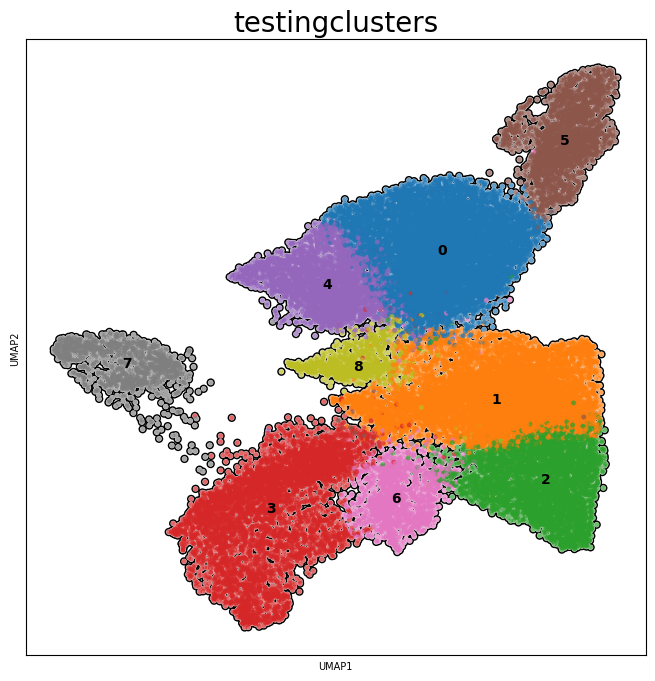

In [26]:
##Merge over-clustered clusters based on gene expression and spatial distribution
combine_adata_st.obs['leiden'][combine_adata_st.obs['leiden'].isin(['7'])]='3'
combine_adata_st.obs['leiden']=combine_adata_st.obs['leiden'].astype('str').astype('category')
### Reorder and rename the Leiden
combine_adata_st.obs['leiden'].cat.rename_categories(np.arange(len(np.unique(combine_adata_st.obs['leiden']))).astype('str'), inplace=True)



# Plot updated umap
fig,ax = plt.subplots(figsize=(8,8))
for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] +
             ax.get_xticklabels() + ax.get_yticklabels()):
    item.set_fontsize(7)
ax=sc.pl.umap(combine_adata_st, color='leiden',legend_loc='on data',legend_fontsize = 10, s = 50, ax=ax,show=False, add_outline = True)
# sc.pl.umap(adata,size=4, color='sample',legend_fontweight=100,legend_fontsize =20,ax=ax,show=False)
ax.set_title('testingclusters')
ax.title.set_fontsize(20)



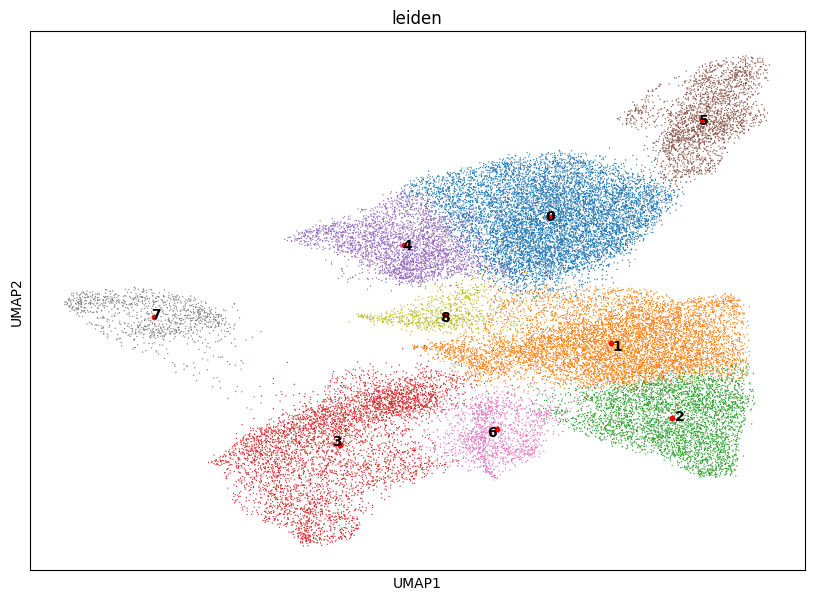

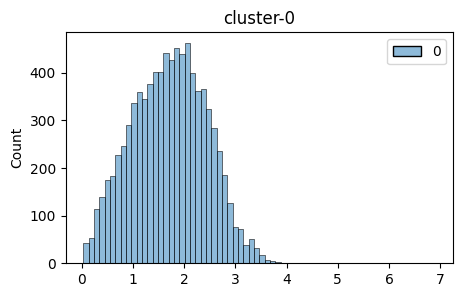

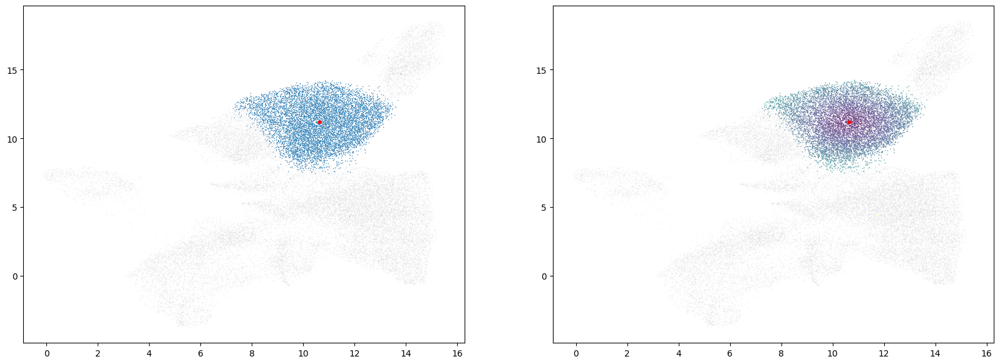

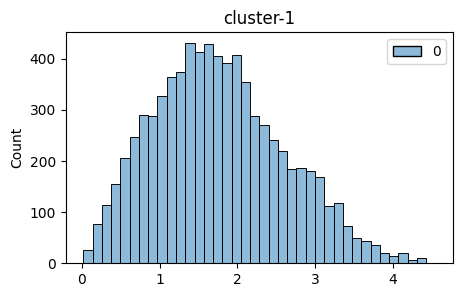

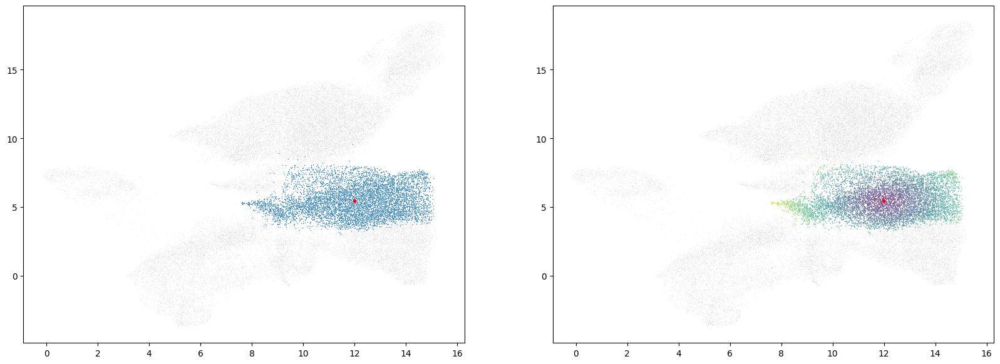

...

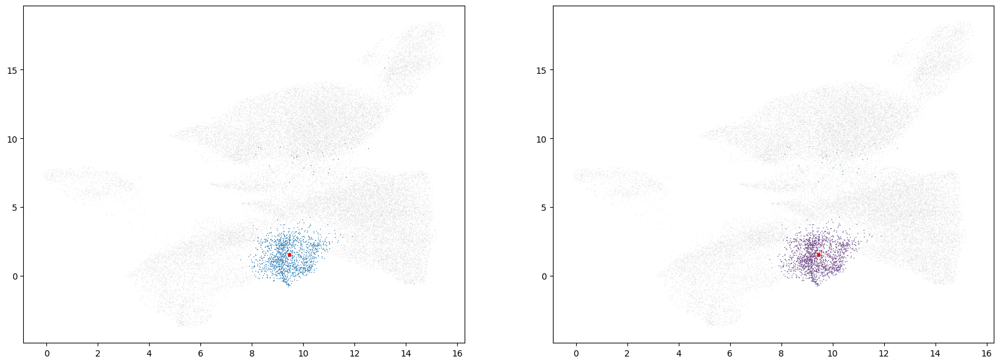

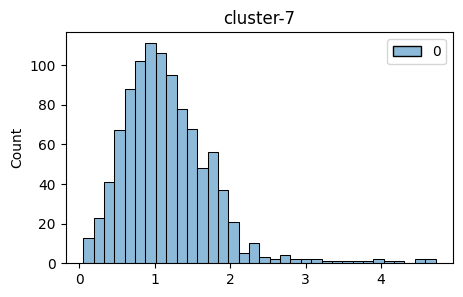

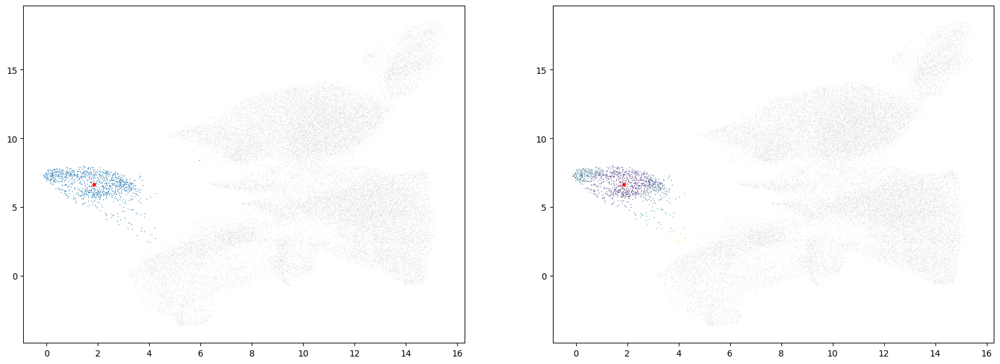

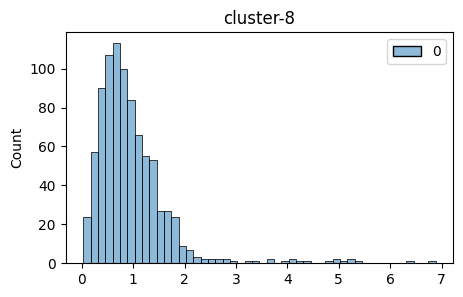

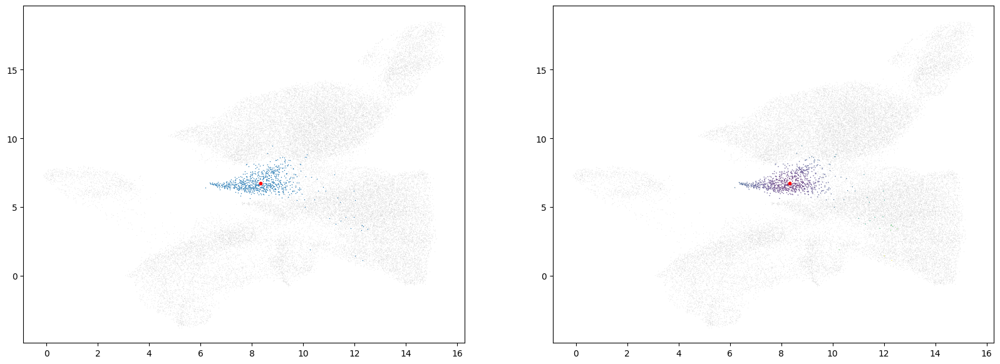

In [29]:
# remove mixed cells
# calculate the distance between each cell and its leiden cluster center
combine_adata_st.obs['distance2centroid_leiden'] = 9999

# find centroid of each leiden cluster
from sklearn.neighbors import NearestCentroid
from scipy.spatial.distance import cdist
clf = NearestCentroid(shrink_threshold=None)
clf.fit(combine_adata_st.obsm['X_umap'], combine_adata_st.obs.leiden)

# plot cluster center
fig, ax = plt.subplots(figsize=(10,7))
sc.pl.umap(combine_adata_st, color='leiden', ax=ax, show=False, legend_loc='on data')
ax.scatter(clf.centroids_[:, 0], clf.centroids_[:, 1], s=10, c='r')
plt.show()

for i, current_label in enumerate(sorted(combine_adata_st.obs['leiden'].cat.categories)):
    current_centroid = clf.centroids_[i, :].reshape([1,2])
    
    # check centroid location 
    # fig, ax = plt.subplots(figsize=(10,7))
    # sc.pl.umap(adata, color='leiden', ax=ax, show=False, legend_loc='on data', title=f'cluster-{current_label}')
    # ax.scatter(current_centroid[:, 0], current_centroid[:, 1], s=10, c='r')
    # plt.show()

    # calculate distance 
    dm = cdist(combine_adata_st[combine_adata_st.obs['leiden'] == current_label, :].obsm['X_umap'], current_centroid)
    combine_adata_st.obs.loc[combine_adata_st.obs['leiden'] == current_label, 'distance2centroid_leiden'] = dm

    # plot distance distribution
    fig, ax = plt.subplots(figsize=(5,3))
    sns.histplot(dm)
    plt.title(f'cluster-{current_label}')
    plt.show()
    
    # visualize distance calculation 
    fig, axs = plt.subplots(figsize=(20,7), nrows=1, ncols=2)
    sns.scatterplot(combine_adata_st.obsm['X_umap'][:, 0], combine_adata_st.obsm['X_umap'][:, 1], color='#1111', s=1, ax=axs[0])
    sns.scatterplot(combine_adata_st[combine_adata_st.obs['leiden'] == current_label, :].obsm['X_umap'][:, 0], combine_adata_st[combine_adata_st.obs['leiden'] == current_label, :].obsm['X_umap'][:, 1], s=1, legend=None, ax=axs[0])
    axs[0].scatter(current_centroid[:, 0], current_centroid[:, 1], s=10, c='r')

    sns.scatterplot(combine_adata_st.obsm['X_umap'][:, 0], combine_adata_st.obsm['X_umap'][:, 1], color='#1111', s=1, ax=axs[1])
    sns.scatterplot(combine_adata_st[combine_adata_st.obs['leiden'] == current_label, :].obsm['X_umap'][:, 0], combine_adata_st[combine_adata_st.obs['leiden'] == current_label, :].obsm['X_umap'][:, 1], 
                    hue=combine_adata_st.obs.loc[combine_adata_st.obs['leiden'] == current_label, 'distance2centroid_leiden'], palette='viridis', s=1, legend=None, ax=axs[1])
    axs[1].scatter(current_centroid[:, 0], current_centroid[:, 1], s=10, c='r')
    plt.show()


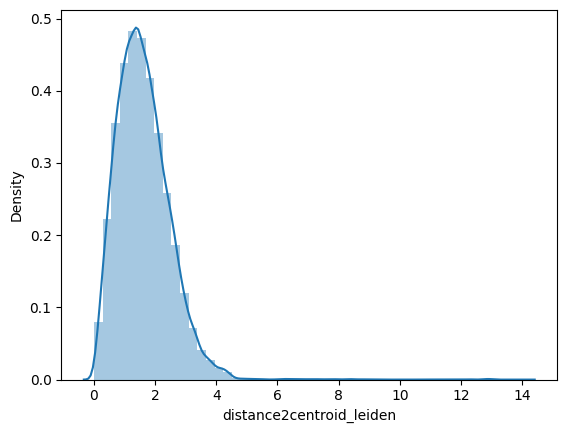

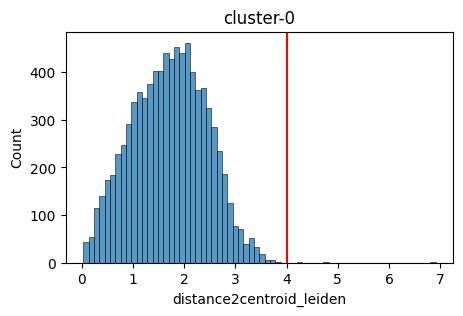

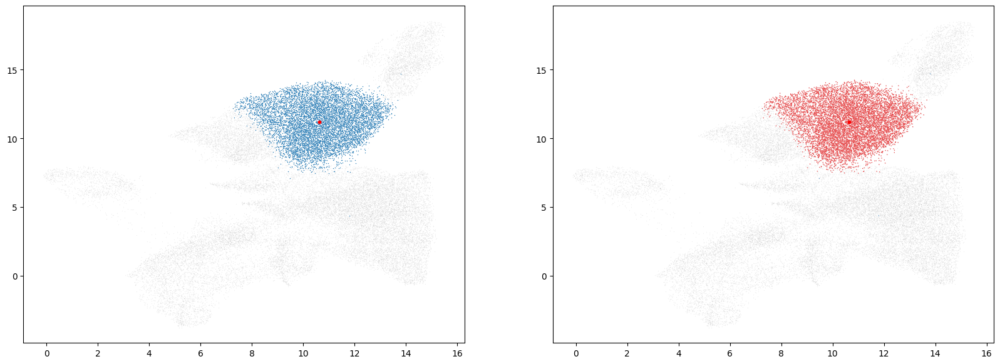

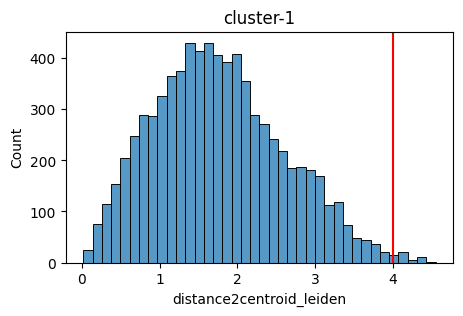

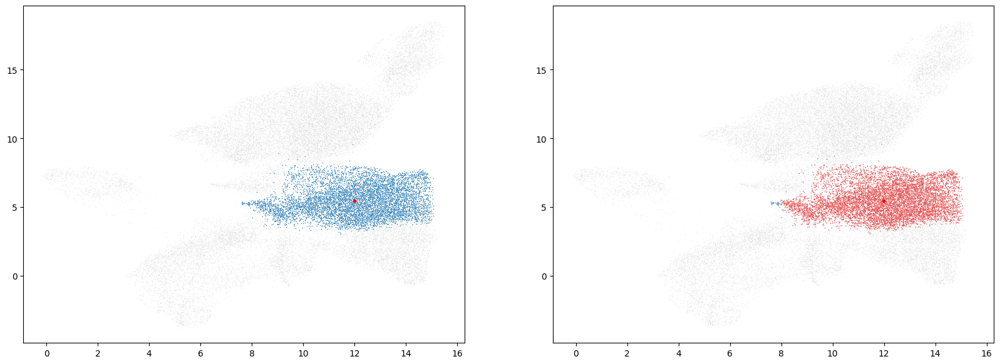

...

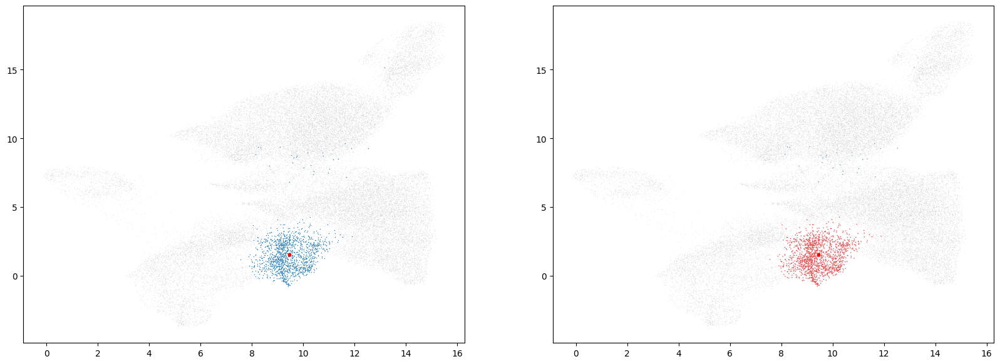

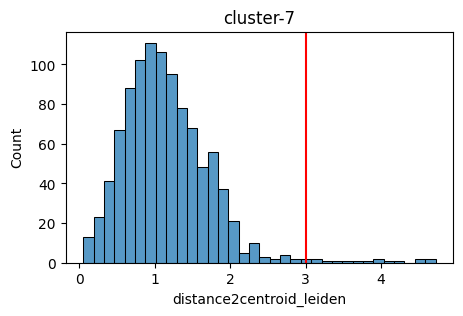

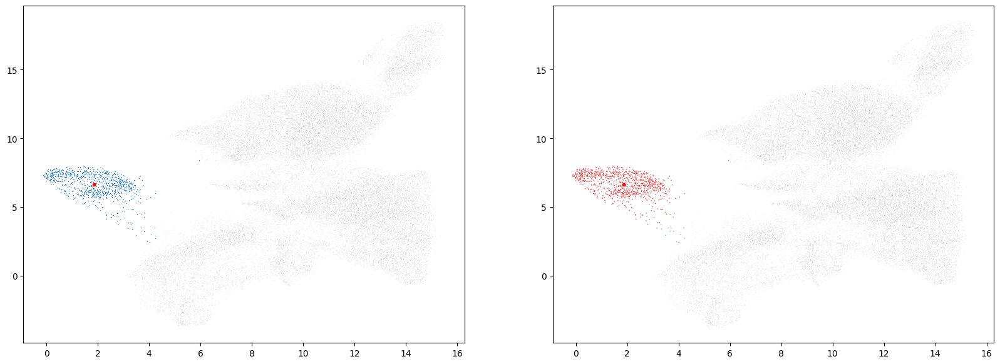

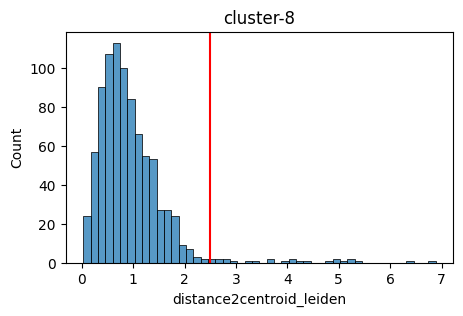

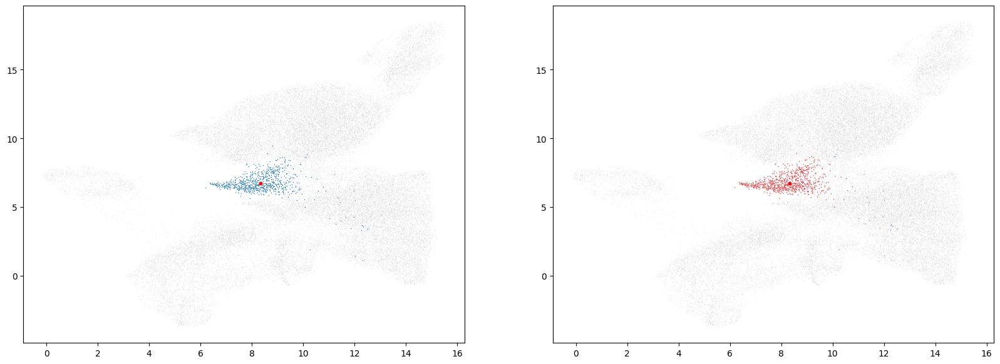

In [31]:
# classify mix cells 
manual_threshold = [
    4, # 0
    4, # 1
    4, # 2
    5, # 3
    3, # 4
    4, # 5
    3, # 6
    3, # 7
    2.5, # 8
]
combine_adata_st.obs['is_mix'] = 'False'

# plot overall distance distribution
sns.distplot(combine_adata_st.obs['distance2centroid_leiden'])

for i, current_label in enumerate(sorted(combine_adata_st.obs['leiden'].cat.categories)):
    current_centroid = clf.centroids_[i, :].reshape([1,2])
    
    # plot distance distribution of current cluster
    fig, ax = plt.subplots(figsize=(5,3))
    sns.histplot(combine_adata_st.obs.loc[combine_adata_st.obs['leiden'] == current_label, 'distance2centroid_leiden'])
    ax.axvline(x=manual_threshold[i], c='r')
    plt.title(f'cluster-{current_label}')
    plt.show()
    
    combine_adata_st.obs.loc[(combine_adata_st.obs['leiden'] == current_label) & (combine_adata_st.obs['distance2centroid_leiden'] > manual_threshold[i]), 'is_mix'] = 'True'
    combine_adata_st.obs['is_mix'] = combine_adata_st.obs['is_mix'].astype('category')
    
    fig, axs = plt.subplots(figsize=(20,7), nrows=1, ncols=2)
    sns.scatterplot(combine_adata_st.obsm['X_umap'][:, 0], combine_adata_st.obsm['X_umap'][:, 1], color='#1111', s=1, ax=axs[0])
    sns.scatterplot(combine_adata_st[combine_adata_st.obs['leiden'] == current_label, :].obsm['X_umap'][:, 0], combine_adata_st[combine_adata_st.obs['leiden'] == current_label, :].obsm['X_umap'][:, 1], s=1, legend=None, ax=axs[0])
    axs[0].scatter(current_centroid[0, 0], current_centroid[0, 1], s=10, c='r')

    sns.scatterplot(combine_adata_st.obsm['X_umap'][:, 0], combine_adata_st.obsm['X_umap'][:, 1], color='#1111', s=1, ax=axs[1])
    sns.scatterplot(combine_adata_st[combine_adata_st.obs['leiden'] == current_label, :].obsm['X_umap'][:, 0], combine_adata_st[combine_adata_st.obs['leiden'] == current_label, :].obsm['X_umap'][:, 1], 
                    hue=combine_adata_st.obs.loc[combine_adata_st.obs['leiden'] == current_label, 'is_mix'], palette='Set1', s=1, legend=None, ax=axs[1])
    axs[1].scatter(current_centroid[0, 0], current_centroid[0, 1], s=10, c='r')

In [33]:
# create backup for leiden label
combine_adata_st.obs['orig_leiden'] = combine_adata_st.obs['leiden'].values

combine_adata_st.obs['level_1'] = combine_adata_st.obs['leiden'].values


In [41]:
# Change cluster label to cell type label
transfer_dict_l1 = {}

# Level_1
level_1_list = [
    'GABAergic 1', #0
    'Glutamatergic 1', #1
    'vlPAG', #2
    'Serotonergic', #3
    'GABAergic 2', #4
    'GABAergic 3', #5
    'Glutamatergic 2', #6
    'Dopaminergic', #7
    'GABA_Glu' #8
]

# construct transfer dict
for i in sorted(combine_adata_st.obs['leiden'].unique()):
    transfer_dict_l1[i] = level_1_list[int(i)]


In [42]:
# Assign cell type to sdata
combine_adata_st.obs = combine_adata_st.obs.replace({'level_1': transfer_dict_l1})

In [43]:
combine_adata_st.obs['level_1'] = combine_adata_st.obs['level_1'].astype(object)

combine_adata_st.obs.loc[combine_adata_st.obs['is_mix'] == 'True', 'level_1'] = 'Mix'


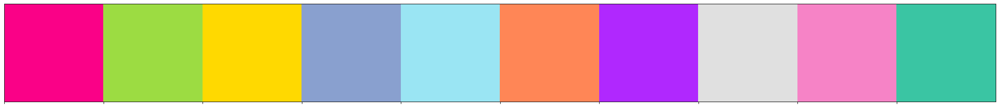

In [62]:
# Check color legend (old coloring scheme)
level_2_colors = ['#FA0187', ##Dopa
                  '#9CDC42', ##GABA_Glu
                  '#FFD900', ##GABA1
                  '#89A0CF', ##GABA2
                  '#9AE5F3',  ##GABA3
                  '#FF8656',  ##Glu1
                  '#B028FE', ##Glu2 
                  '#e0e0e0',##Mix 
                  '#F683C6', 
                  '#3AC5A3' 
                 ]
level_2_pl = sns.color_palette(level_2_colors)
sns.palplot(level_2_pl, size=3)



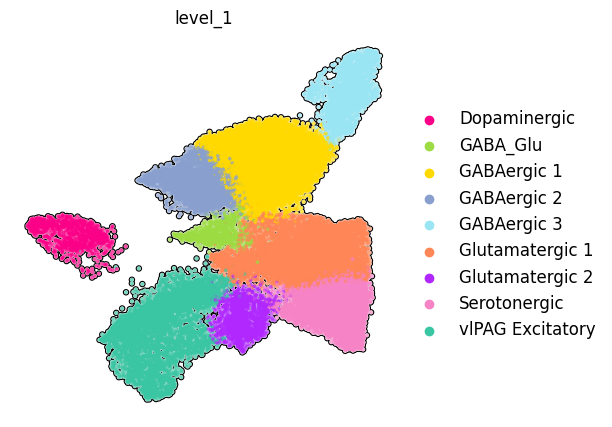

In [45]:
plt.rcParams['figure.figsize'] = (5, 5)  # Width, Height in inches

# Your existing code
non_mix_cells = combine_adata_st[combine_adata_st.obs['level_1'] != 'Mix']
sc.pl.umap(non_mix_cells, color='level_1', legend_loc='right margin',
           legend_fontsize=12, legend_fontoutline=2, frameon=False, palette=level_2_pl, s=30,  
           add_outline=True, save = 'NeurononlyUmap.pdf')


In [11]:
# backup 
combine_adata_st.write_h5ad(f"{out_path}/240201_neuronsonly_Annotated.h5ad")

# Dopaminergic Subclustering

In [60]:
dopaminergic_subset = adata[(adata.obs['dataset'] == 'STAR-RIBOmap') & (adata.obs['level_1'] == 'Dopaminergic'), :]
dopaminergic_subset

View of AnnData object with n_obs × n_vars = 980 × 227
    obs: 'sample', 'area', 'protocol', 'x', 'y', 'seg_label', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_5_genes', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'n_genes', 'n_counts', 'protocol-sample', 'nGene', 'nUMI', 'Reads', 'UMIFM', 'BatchID', 'Condition', 'orig.ident', 'Sex', 'percent.mito', 'var.ratio.pca', 'res.3', 'ClusterNumbers_cca.aligned_1.35_res_3', 'res.2', 'ClusterNumbers_cca.aligned_1.35_res_2', 'tree.ident', 'ClusterTreeNumbers_filtered', 'CellClassNames_filtered', 'Curated_subtypeLabels', 'Curated_cellTypeLabels', 'Curated_cellTypeLabels_ordered', 'batch', 'dataset', 'leiden', 'combine_leiden_res1', 'distance2centroid_leiden', 'is_mix', 'orig_leiden', 'level_1'
    var: 'max_counts_sample1_STARmap-STAR-RIBOmap', 'max_counts_sample2_STARmap-STAR-RIBOmap', 'max_counts_sample3_STARmap-STAR-RIBOmap', 'max_counts

In [61]:
dopaminergic_subset = dopaminergic_subset.copy()
dopaminergic_subset

AnnData object with n_obs × n_vars = 980 × 227
    obs: 'sample', 'area', 'protocol', 'x', 'y', 'seg_label', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_5_genes', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'n_genes', 'n_counts', 'protocol-sample', 'nGene', 'nUMI', 'Reads', 'UMIFM', 'BatchID', 'Condition', 'orig.ident', 'Sex', 'percent.mito', 'var.ratio.pca', 'res.3', 'ClusterNumbers_cca.aligned_1.35_res_3', 'res.2', 'ClusterNumbers_cca.aligned_1.35_res_2', 'tree.ident', 'ClusterTreeNumbers_filtered', 'CellClassNames_filtered', 'Curated_subtypeLabels', 'Curated_cellTypeLabels', 'Curated_cellTypeLabels_ordered', 'batch', 'dataset', 'leiden', 'combine_leiden_res1', 'distance2centroid_leiden', 'is_mix', 'orig_leiden', 'level_1'
    var: 'max_counts_sample1_STARmap-STAR-RIBOmap', 'max_counts_sample2_STARmap-STAR-RIBOmap', 'max_counts_sample3_STARmap-STAR-RIBOmap', 'max_counts_sample4

In [244]:
# backup 
dopaminergic_subset.write_h5ad(f"{out_path}/240204_DopaminergicSubsetFinal.h5ad")

In [231]:
# Run PCA
sc.tl.pca(dopaminergic_subset, n_comps =10,svd_solver='arpack')
sc.pp.neighbors(dopaminergic_subset, n_neighbors=20, n_pcs=10)
sc.tl.umap(dopaminergic_subset, random_state = 10)
sc.tl.leiden(dopaminergic_subset, resolution=0.5)

In [232]:
cluster_pl=list(np.random.rand(len(dopaminergic_subset.obs['leiden'] .unique()),3))

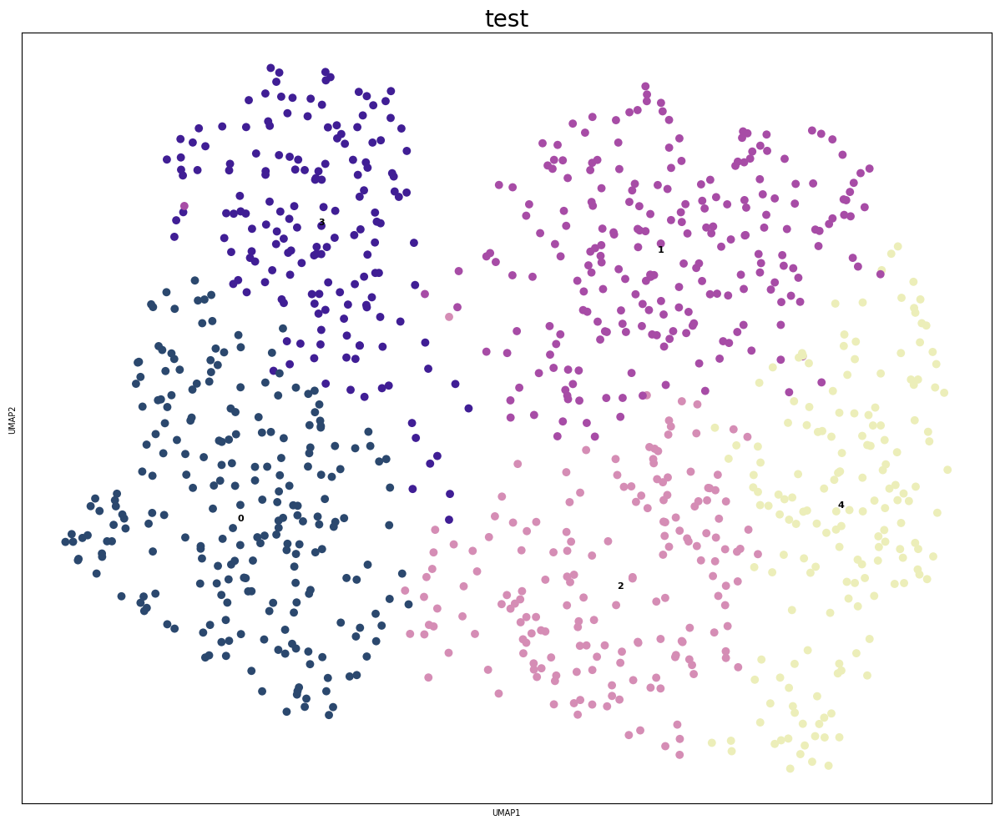

In [233]:
fig,ax = plt.subplots(figsize=(15,12))
for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] +
             ax.get_xticklabels() + ax.get_yticklabels()):
    item.set_fontsize(7)
ax=sc.pl.umap(dopaminergic_subset,size=200, 
              legend_loc='on data',color='leiden',
              legend_fontsize=8,
              palette = cluster_pl,
              ax=ax,show=False)
ax.set_title('test')
ax.title.set_fontsize(20)

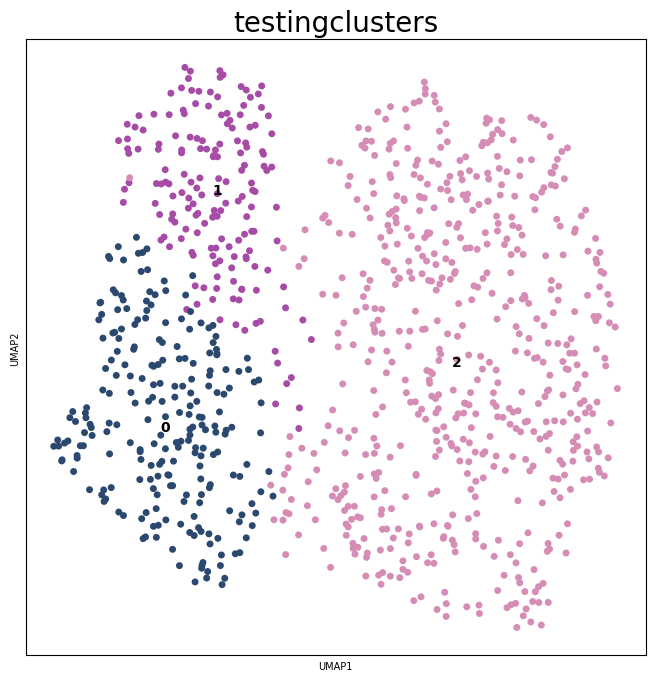

In [235]:
##Merge similar over-clustered clusters based on gene expression and spatial distribution


dopaminergic_subset.obs['leiden'][dopaminergic_subset.obs['leiden'].isin(['1', '2'])]='4'
dopaminergic_subset.obs['leiden']=dopaminergic_subset.obs['leiden'].astype('str').astype('category')
dopaminergic_subset.obs['leiden'].cat.rename_categories(np.arange(len(np.unique(dopaminergic_subset.obs['leiden']))).astype('str'), inplace=True)

# Plot updated umap
fig,ax = plt.subplots(figsize=(8,8))
for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] +
             ax.get_xticklabels() + ax.get_yticklabels()):
    item.set_fontsize(7)
ax=sc.pl.umap(dopaminergic_subset, color='leiden',legend_loc='on data',legend_fontsize = 10, s = 100, ax=ax,show=False)
ax.set_title('testingclusters')
ax.title.set_fontsize(20)



In [237]:
dopaminergic_subset.obs['annotated_DA'] = dopaminergic_subset.obs['leiden']

category_mapping = {
    '0': 'TH1',  
    '2': 'TH2',  
    '1': 'TH3',  
}

dopaminergic_subset.obs['annotated_DA'] = dopaminergic_subset.obs['annotated_DA'].map(category_mapping)



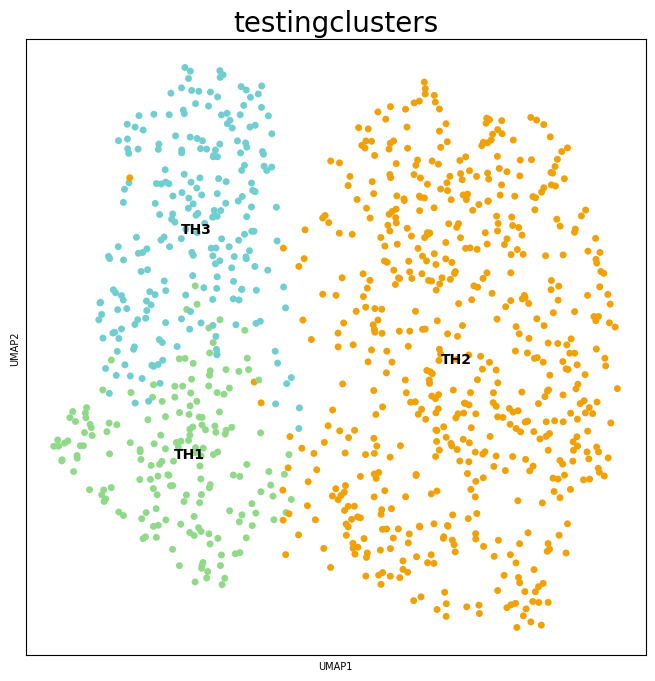

In [217]:
# Plot updated umap
fig,ax = plt.subplots(figsize=(8,8))
for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] +
             ax.get_xticklabels() + ax.get_yticklabels()):
    item.set_fontsize(7)
ax=sc.pl.umap(dopaminergic_subset, color='annotated_DA',legend_loc='on data',legend_fontsize = 10, s = 100, ax=ax,show=False)
ax.set_title('testingclusters')
ax.title.set_fontsize(20)

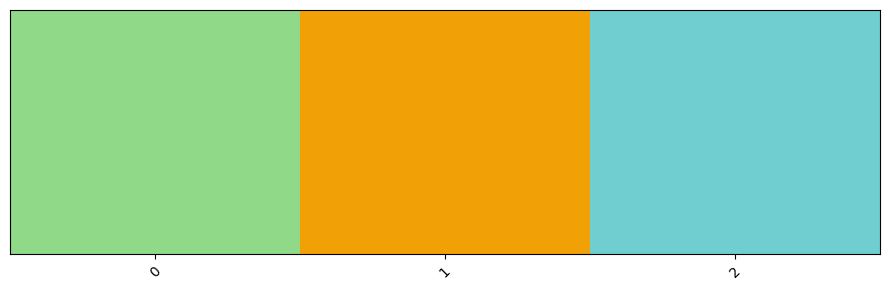

In [190]:
# Check color legend (old coloring scheme)
DAColor = ['#8FD988', '#F1A106', '#70CED0']
DAColor_pl = sns.color_palette(DAColor)
sns.palplot(DAColor_pl, size=3)
plt.xticks(range(len(category_mapping)), category_mapping, size=10, rotation=45)
plt.tight_layout()
# plt.savefig(f'./figures/color_legend_top.png')
plt.show()



In [192]:
# Plot updated umap
fig,ax = plt.subplots(figsize=(8,8))
for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] +
             ax.get_xticklabels() + ax.get_yticklabels()):
    item.set_fontsize(7)
ax=sc.pl.umap(dopaminergic_subset, color='annotated_DA',legend_loc='right margin',palette = DAColor_pl, legend_fontsize = 10,s = 1000, ax=ax,show=False, add_outline = True, outline_width=(0.1, 0.02), save = '240205_DASubclusterumap_2.pdf')
# sc.pl.umap(adata,size=4, csolor='sample',legend_fontweight=100,legend_fontsize =20,ax=ax,show=False)
ax.set_title('testingclusters')
ax.title.set_fontsize(20)